<a href="https://colab.research.google.com/github/ShayEK34/DL-Assignment4-Super_Resolution/blob/main/Ass_4_Super_Resolution_main.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

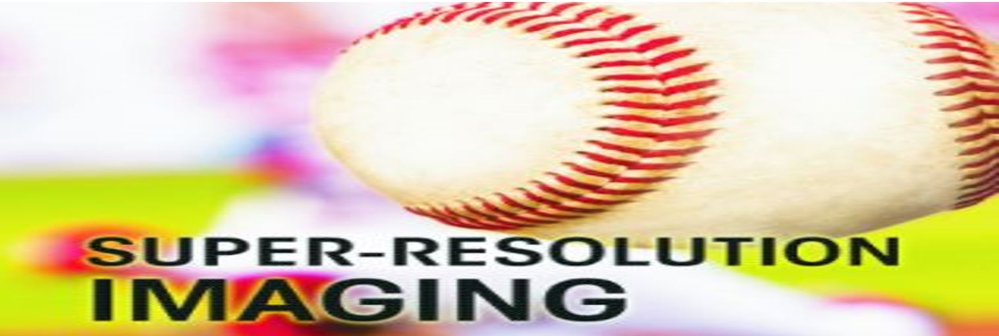

# **Image Super-Resolution Exercise**

In [1]:
import glob
import cv2
import matplotlib.pyplot as plt
from tensorflow.keras.layers import *
from tensorflow.keras.models import Model
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau
from keras.preprocessing.image import ImageDataGenerator, load_img
from tensorflow import keras
from tensorflow import image

import math
from keras import backend as K
import shutil

import imageio
import numpy as np
import pandas as pd
import requests
import tarfile
import os
import tensorflow as tf
from ipywidgets import Image
from IPython import display
from pathlib import Path

# from ipywidgets import Image
# from IPython.display import Image


# **Step 1: Create dataset – we would like to create a dataset and a data-loader for the training of super-resolution network We will use self-supervision to create our dataset**


In [2]:
IMAGE_PATH = "VOCdevkit/VOC2007/JPEGImages"

In [3]:
if not os.path.isdir('data'):
  data = requests.get("http://host.robots.ox.ac.uk/pascal/VOC/voc2007/VOCtrainval_06-Nov-2007.tar")
  with open("data.tar", 'wb') as f:
      f.write(data.content) 

  tar = tarfile.open("data.tar")
  tar.extractall()
  tar.close()

In [4]:
file_list = glob.glob(IMAGE_PATH+'/*.jpg')
file_list[:10]

['VOCdevkit/VOC2007/JPEGImages/007855.jpg',
 'VOCdevkit/VOC2007/JPEGImages/006841.jpg',
 'VOCdevkit/VOC2007/JPEGImages/004397.jpg',
 'VOCdevkit/VOC2007/JPEGImages/007908.jpg',
 'VOCdevkit/VOC2007/JPEGImages/002315.jpg',
 'VOCdevkit/VOC2007/JPEGImages/005396.jpg',
 'VOCdevkit/VOC2007/JPEGImages/000816.jpg',
 'VOCdevkit/VOC2007/JPEGImages/009004.jpg',
 'VOCdevkit/VOC2007/JPEGImages/002460.jpg',
 'VOCdevkit/VOC2007/JPEGImages/003849.jpg']

In [5]:
num_imgs = 100

x = [] 
y_mid = []
y_large = []

for f in file_list[:num_imgs]:
  # img = cv2.imread(f)/255.
  img = imageio.imread(f)/255.
  x.append(cv2.resize(img, (72,72)))
  y_mid.append(cv2.resize(img, (144,144)))
  y_large.append(cv2.resize(img, (288,288)))

x = np.array(x)
y_mid = np.array(y_mid)
y_large = np.array(y_large)

x.shape, y_mid.shape, y_large.shape


((100, 72, 72, 3), (100, 144, 144, 3), (100, 288, 288, 3))

In [6]:
num_imgs2 = 12

x2 = [] 
y_mid2 = []
y_large2 = []

for f in file_list[:num_imgs2]:
  # img = cv2.imread(f)/255.
  img = imageio.imread(f)/255.
  x2.append(cv2.resize(img, (72,72)))
  y_mid2.append(cv2.resize(img, (144,144)))
  y_large2.append(cv2.resize(img, (288,288)))

x2 = np.array(x2)
y_mid2 = np.array(y_mid2)
y_large2 = np.array(y_large2)

x2.shape, y_mid2.shape, y_large2.shape


((12, 72, 72, 3), (12, 144, 144, 3), (12, 288, 288, 3))

In [7]:
if not (os.path.isdir('train_dir')):
  base_dir = 'train_dir'
  os.mkdir(base_dir)
  shutil.move(IMAGE_PATH, "train_dir")

In [8]:
new_images_path = 'train_dir'

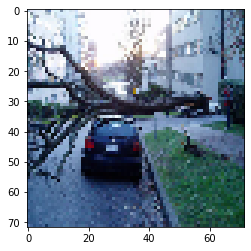

In [9]:
plt.imshow(x[5])

In [9]:
def plot_multi_imgs (index,x,y_mid,y_large):
  fig, ax = plt.subplots(1,3,figsize=(18,5))
  ax[0].set_title('Original size 72x72')
  ax[0].imshow(x[index])
  ax[1].set_title('Original size 144x144')
  ax[1].imshow(y_mid[index])
  ax[2].set_title('Original size 288x288')
  ax[2].imshow(y_large[index])
# plot_multi_imgs(0,x,y_mid,y_large)


In [10]:
def plot_three_images_origin(num):
  for i in range(0,3):
    plot_multi_imgs(num,x,y_mid,y_large)
    num = num + 1

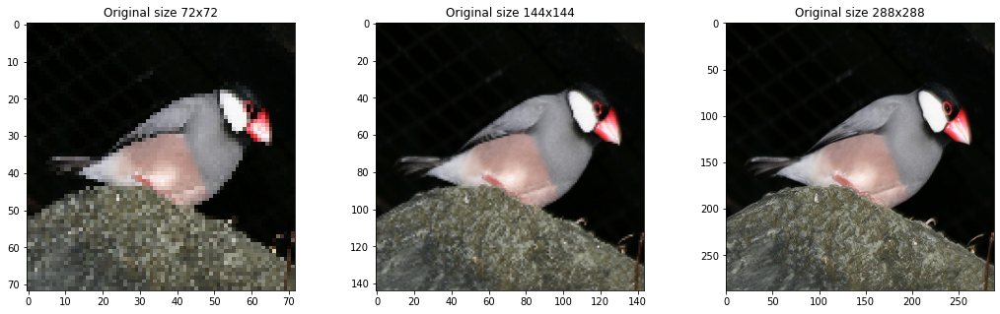

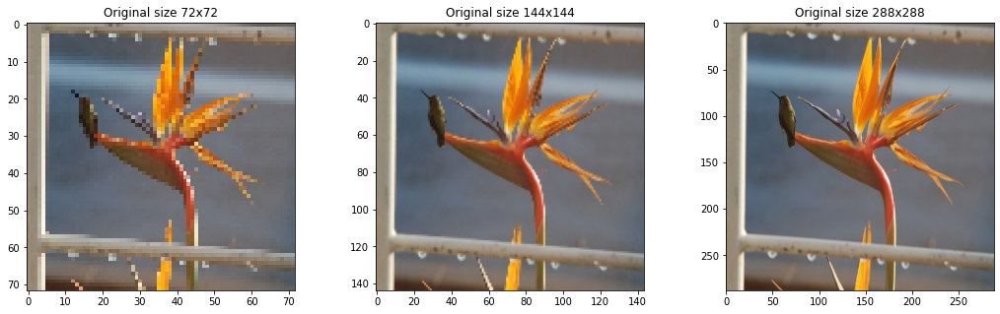

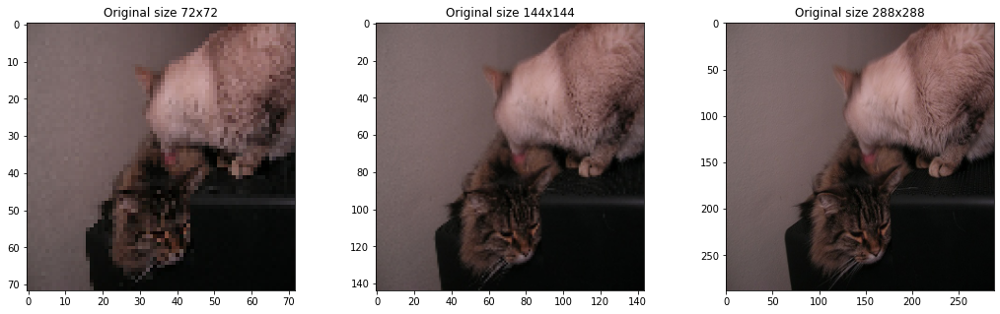

In [12]:
plot_three_images_origin(9)

# **Define main functions and classes:**

## **PSNR**

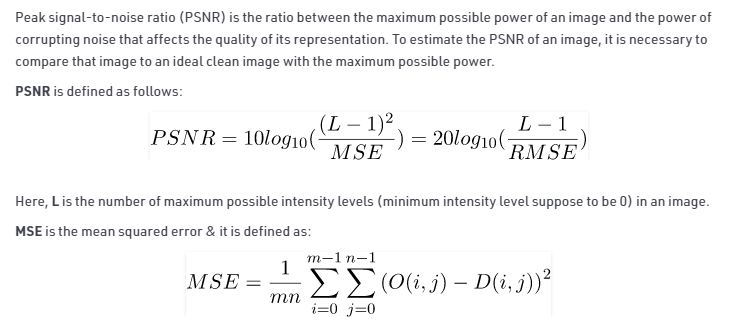

In [11]:
# use_psnr = True - Loss is defined PSNR for all the models
# use_psnr = False - Loss is defined MSE for all the models
use_psnr = False

In [14]:
# def PSNR(y_true, y_pred):
#     max_pixel = 1.0
#     return (10.0 * K.log((max_pixel ** 2) / (K.mean(K.square(y_pred - y_true), axis=-1)))) / 2.303

In [12]:
def PSNR(y_true, y_pred):
  if use_psnr:
    return -image.psnr(y_true, y_pred,1)
  else:
    return image.psnr(y_true, y_pred,1)

## **Callbacks**


In [13]:
images_pred_per_epoch = {}
images_per_epoch = x2
class PredictionCallback(tf.keras.callbacks.Callback):
  def __init__(self,model_name):
    super().__init__()
    self.model_name = model_name
    images_pred_per_epoch[model_name] = []
  def on_epoch_end(self, epoch, logs={}):
    pred = self.model.predict(images_per_epoch)
    images_pred_per_epoch[self.model_name].append(pred)


In [14]:
def create_callbacks(model_name='base', patience=5, factor=0.1, monitor='val_loss', save_best=True):
    es = EarlyStopping(monitor=monitor, patience=patience, verbose=1,)
    rlr = ReduceLROnPlateau(monitor=monitor, factor=factor, patience=patience)
    model_ckpt = ModelCheckpoint(f'./{model_name}.h5', monitor=monitor, save_best_only=save_best)
    predictions_per_epoch = PredictionCallback(model_name)
    return [es, rlr, model_ckpt,predictions_per_epoch]

## **Gif creation**

In [15]:
def take_images_for_gif(model_name,index_image_size,num_image):
  model_images = images_pred_per_epoch[model_name]
  images_gif = []
  for i in range(0,len(model_images)):
      # images_gif.append(model_images[i][index_image_size])
      if index_image_size == -1:
        data = model_images[i][num_image]
      else:
        data = model_images[i][index_image_size][num_image]
      data = data / data.max() #normalizes data in range 0 - 255
      data = 255 * data
      img = data.astype(np.uint8)
      images_gif.append(img)

  return images_gif

In [16]:
def create_gif(model_name,index_image_size,img_index):
  images_for_gif = take_images_for_gif(model_name,index_image_size,img_index)
  imageio.mimwrite(f'./{model_name}.gif', images_for_gif)

  animatedGif = model_name+'.gif' #path relative to your notebook
  file = open(animatedGif , "rb")
  image = file.read()
  progress= Image(value=image,format='gif', width=250,height=100)
  display.display(progress)

## **Plotting models results**

In [17]:
if use_psnr:
  scores = ["Out_Med_mse","Out_Large_mse","val_Out_Med_mse","val_Out_Large_mse"]
else: 
  scores = ["Out_Med_PSNR","Out_Large_PSNR","val_Out_Med_PSNR","val_Out_Large_PSNR"]

losses = ['loss',"Out_Med_loss","Out_Large_loss","val_Out_Med_loss","val_Out_Large_loss"]

In [18]:
def history_to_plot(history, scores, losses):

  history = history.history
  fig, ax = plt.subplots(1,2,figsize=(12,4))

  for score in scores:
      ax[0].plot(history[score])

  ax[0].set_title('Model score')
  ax[0].set_ylabel('Score')
  ax[0].set_xlabel('Epoch')
  ax[0].legend(scores, loc='lower right')

 
  for loss in losses:
    ax[1].plot(history[loss])

  ax[1].set_title('Model loss')
  ax[1].set_ylabel('Loss')
  ax[1].set_xlabel('Epoch')

  ax[1].legend(losses, loc='upper right')
  plt.show()  

## **Plotting images predictions**

In [19]:
def plot_multi_imgs_pred (index,x,original,pred,output_type):
  fig, ax = plt.subplots(1,3,figsize=(18,5))
  ax[0].set_title('Original size 72x72')
  ax[0].imshow(x[index])
  if output_type == 0:
    ax[1].set_title('Original size 144x144')
    ax[1].imshow(original[index])
    ax[2].set_title('Prediction size 144*144')
    ax[2].imshow(pred[index])
  else:
    ax[1].set_title('Original size 288x288')
    ax[1].imshow(original[index])
    ax[2].set_title('Prediction size 288x288')
    ax[2].imshow(pred[index])

In [20]:
def plot_three_images_pred(num,x,original,pred,output_type):
  for i in range(0,3):
    plot_multi_imgs_pred(num,x,original,pred,output_type)
    num = num+1

In [21]:
EPOCHS_NUM = 20

In [22]:
class UnionDataGenerator(keras.utils.Sequence):
    'Generates data for Keras'
    def __init__(self, path, batch_size, mode):
      self.path = path
      self.batch_size = batch_size
      self.mode = mode
        # 'Initialization'
        # self.dim = dim
        # self.files = files
        # self.batch_size = batch_size
        # self.n_channels = n_channels
        # self.n_classes = n_classes
        # self.shuffle = shuffle
        # self.on_epoch_end()

      generator1 = ImageDataGenerator(rescale=1./255,validation_split=0.2)
      generator2 = ImageDataGenerator(rescale=1./255,validation_split=0.2)
      generator3 = ImageDataGenerator(rescale=1./255,validation_split=0.2)

    # 'bicubic'

      data_gen1= generator1.flow_from_directory(directory  = self.path,
                                                target_size=(72,72),
                                                color_mode = 'rgb',
                                                seed =7,
                                                interpolation ='bicubic',
                                                batch_size = self.batch_size,
                                                shuffle = False,
                                                class_mode =None,
                                                subset= self.mode)
      
      data_gen2= generator2.flow_from_directory(directory = self.path,
                                                target_size=(144,144),
                                                color_mode = 'rgb',
                                                seed =7,
                                                interpolation ='bicubic',
                                                batch_size = self.batch_size,
                                                shuffle = False,
                                                class_mode =None,
                                                subset=self.mode)

      data_gen3= generator3.flow_from_directory(directory = self.path,
                                                target_size=(288,288),
                                                color_mode = 'rgb',
                                                seed =7,
                                                interpolation ='bicubic',
                                                batch_size = self.batch_size,
                                                shuffle = False,
                                                class_mode =None,
                                                subset=self.mode)
      self.data_gen1 = data_gen1
      self.data_gen2 = data_gen2
      self.data_gen3 = data_gen3

    def __len__(self):
      return len(self.data_gen1)

    def __getitem__(self, index):
      x1 = self.data_gen1[index]
      x2 = self.data_gen2[index]
      x3 = self.data_gen3[index]
      return x1, [x2,x3]

    def on_epoch_end(self):
      self.data_gen1.on_epoch_end()
      self.data_gen2.on_epoch_end()
      self.data_gen3.on_epoch_end()

# **Step 2: Create an initial model. In this step, create an initial fully convolutional model with the following architecture:**


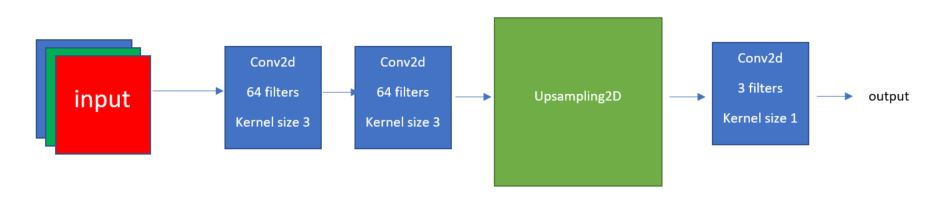

## **Model 1 architecture**

In [26]:
#step 2
def get_simple_model():
  input_shape = (72,72,3)
  inputs = Input(shape=input_shape)
  x = Conv2D(64,(3,3),padding='same',activation='relu')(inputs)
  x = Conv2D(64,(3,3),padding='same',activation='relu')(x)
  x = UpSampling2D(size=2,interpolation='bilinear')(x)
  output_1 = Conv2D(3,kernel_size=1,activation='sigmoid')(x)
  
  model = Model(inputs=inputs, outputs=[output_1])
  if use_psnr:
    model.compile(loss=PSNR,optimizer='adam',metrics=['acc','mse'])
  else:
    model.compile(loss='mse',optimizer='adam',metrics=['acc',PSNR])
  return model

model = get_simple_model()
model.summary()


Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 72, 72, 3)]       0         
_________________________________________________________________
conv2d (Conv2D)              (None, 72, 72, 64)        1792      
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 72, 72, 64)        36928     
_________________________________________________________________
up_sampling2d (UpSampling2D) (None, 144, 144, 64)      0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 144, 144, 3)       195       
Total params: 38,915
Trainable params: 38,915
Non-trainable params: 0
_________________________________________________________________


In [27]:
split = num_imgs//5*4
model.fit(x[:split],y_mid[:split],validation_data = (x[split:],y_mid[split:]),epochs=EPOCHS_NUM,callbacks=[create_callbacks('model_1')])

Epoch 1/20
3/3 [==============================] - 4s 347ms/step - loss: 0.0895 - acc: 0.2166 - PSNR: 10.8576 - val_loss: 0.0808 - val_acc: 0.4953 - val_PSNR: 11.1672
Epoch 2/20
3/3 [==============================] - 0s 40ms/step - loss: 0.0832 - acc: 0.5419 - PSNR: 11.2009 - val_loss: 0.0785 - val_acc: 0.4992 - val_PSNR: 11.2995
Epoch 3/20
3/3 [==============================] - 0s 41ms/step - loss: 0.0820 - acc: 0.5757 - PSNR: 11.2968 - val_loss: 0.0750 - val_acc: 0.5155 - val_PSNR: 11.5014
Epoch 4/20
3/3 [==============================] - 0s 44ms/step - loss: 0.0781 - acc: 0.6377 - PSNR: 11.4719 - val_loss: 0.0707 - val_acc: 0.5766 - val_PSNR: 11.7642
Epoch 5/20
3/3 [==============================] - 0s 39ms/step - loss: 0.0733 - acc: 0.6257 - PSNR: 11.7244 - val_loss: 0.0650 - val_acc: 0.5549 - val_PSNR: 12.1362
Epoch 6/20
3/3 [==============================] - 0s 39ms/step - loss: 0.0662 - acc: 0.6071 - PSNR: 12.1864 - val_loss: 0.0587 - val_acc: 0.6491 - val_PSNR: 12.5824
Epoch 7/2

In [28]:
pred = model.predict(x2)

## **Modle 1 plotting image predictions results**

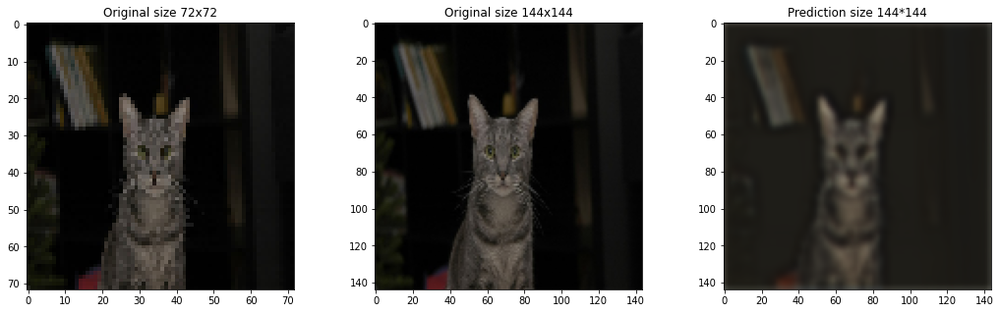

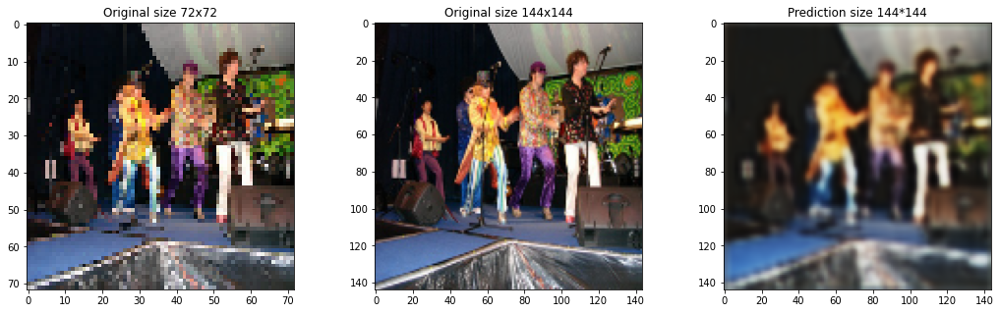

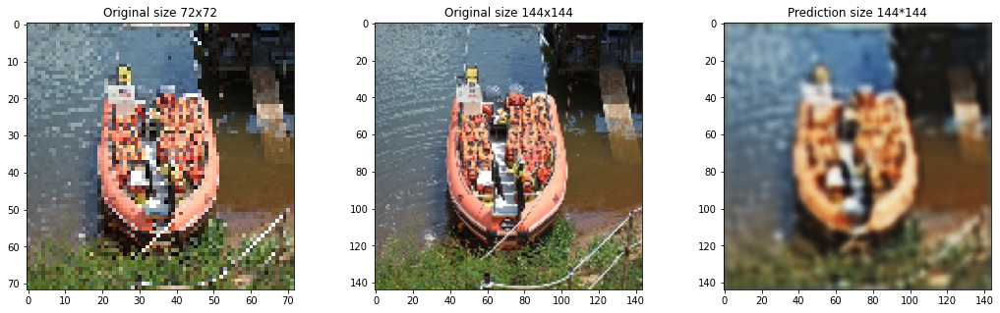

In [29]:
plot_three_images_pred(0,x2,y_mid2,pred,0)

## **Gif for modle 1 predictions**

Gif for images predictions size 288x288 of model 1

In [30]:
create_gif('model_1',-1,0)

Image(value=b'GIF89a\x90\x00\x90\x00\x87\x00\x00\xfd\xfa\xe3\xfa\xf9\xe5\xfb\xf8\xe5\xfa\xf8\xe5\xfb\xf8\xe3\x…

# **Step 3: add another block to your model so that you’ll have both 144x144x3 output along with 288x288x3 output as follows: (make sure you understand the dimensions in each step of the process)**


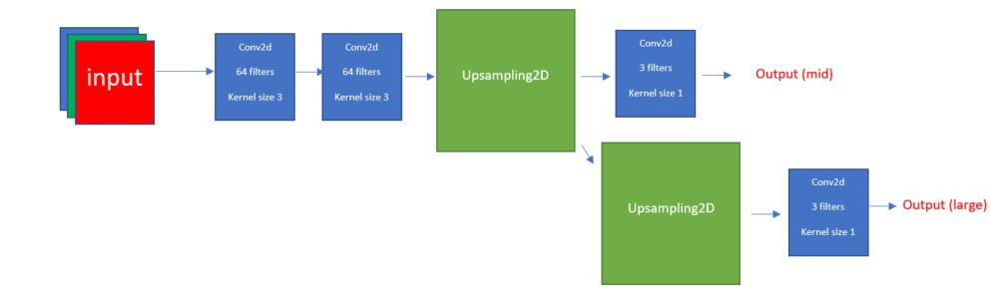

## **Model 2 architecture**

In [31]:
#step 3
def get_dual_model():
  input_shape = (72,72,3)
  inputs = Input(shape=input_shape)
  x = Conv2D(64,(3,3),padding='same',activation='relu')(inputs)
  x = Conv2D(64,(3,3),padding='same',activation='relu')(x)
  x = UpSampling2D(size=2,interpolation='bilinear')(x)
  out1 = Conv2D(3,kernel_size=1,activation='sigmoid',name = 'Out_Med')(x)

  out2 = UpSampling2D(size=2,interpolation='bilinear')(x)
  out2 = Conv2D(3,kernel_size=1,activation='sigmoid',name = 'Out_Large')(out2)
  
  model_dual = Model(inputs=inputs, outputs=[out1,out2])
  if use_psnr:
    model_dual.compile(loss=PSNR,optimizer='adam',metrics=['acc','mse'])
  else:
    model_dual.compile(loss='mse',optimizer='adam',metrics=['acc',PSNR])
  return model_dual

dual_model = get_dual_model()
dual_model.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 72, 72, 3)]  0                                            
__________________________________________________________________________________________________
conv2d_3 (Conv2D)               (None, 72, 72, 64)   1792        input_2[0][0]                    
__________________________________________________________________________________________________
conv2d_4 (Conv2D)               (None, 72, 72, 64)   36928       conv2d_3[0][0]                   
__________________________________________________________________________________________________
up_sampling2d_1 (UpSampling2D)  (None, 144, 144, 64) 0           conv2d_4[0][0]                   
____________________________________________________________________________________________

In [32]:
history_2 = dual_model.fit(UnionDataGenerator(new_images_path,16,'training'),
               callbacks=[create_callbacks('model_2')],
               steps_per_epoch = len(file_list)*0.8//16,
               validation_data = UnionDataGenerator(new_images_path,16,'validation'),
               validation_steps = len(file_list)*0.2//16,
               epochs = EPOCHS_NUM)

Found 4009 images belonging to 1 classes.
Found 4009 images belonging to 1 classes.
Found 4009 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Epoch 1/20
250/250 [==============================] - 92s 363ms/step - loss: 0.0600 - Out_Med_loss: 0.0293 - Out_Large_loss: 0.0307 - Out_Med_acc: 0.6756 - Out_Med_PSNR: 18.4306 - Out_Large_acc: 0.6897 - Out_Large_PSNR: 17.6220 - val_loss: 0.0092 - val_Out_Med_loss: 0.0034 - val_Out_Large_loss: 0.0059 - val_Out_Med_acc: 0.8236 - val_Out_Med_PSNR: 25.2383 - val_Out_Large_acc: 0.8105 - val_Out_Large_PSNR: 23.0062
Epoch 2/20
250/250 [==============================] - 90s 362ms/step - loss: 0.0087 - Out_Med_loss: 0.0031 - Out_Large_loss: 0.0056 - Out_Med_acc: 0.8271 - Out_Med_PSNR: 25.6277 - Out_Large_acc: 0.8145 - Out_Large_PSNR: 23.2794 - val_loss: 0.0080 - val_Out_Med_loss: 0.0028 - val_Out_Large_loss: 0.0052 - val_Out_Med_acc: 0.8627 - va

In [33]:
pred1,pred2 = dual_model.predict(x2)

## **Model 2 plotting images predictions**

Prediction for mid size

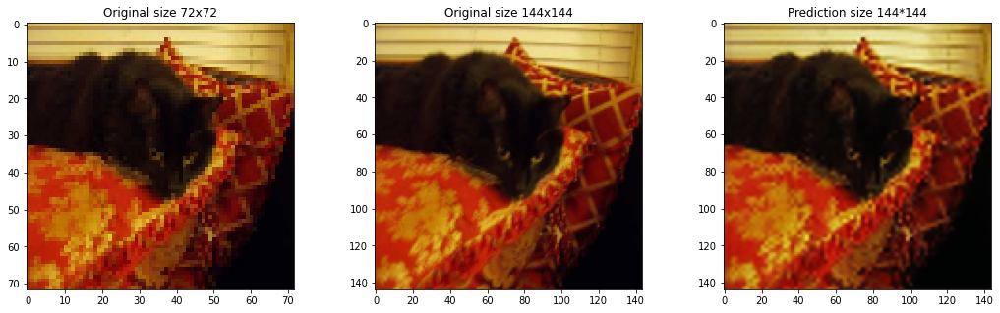

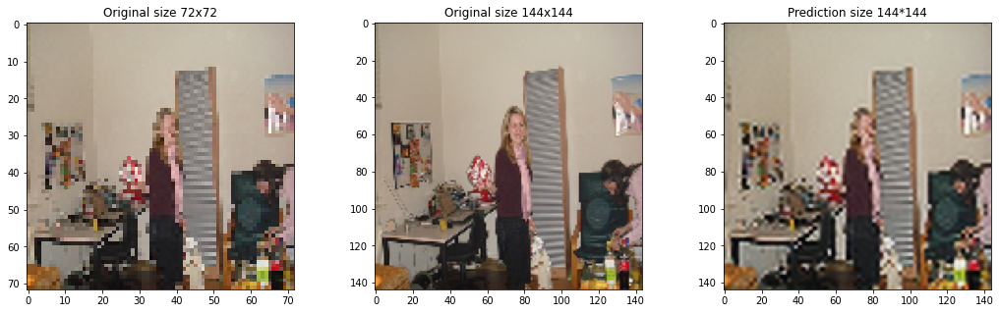

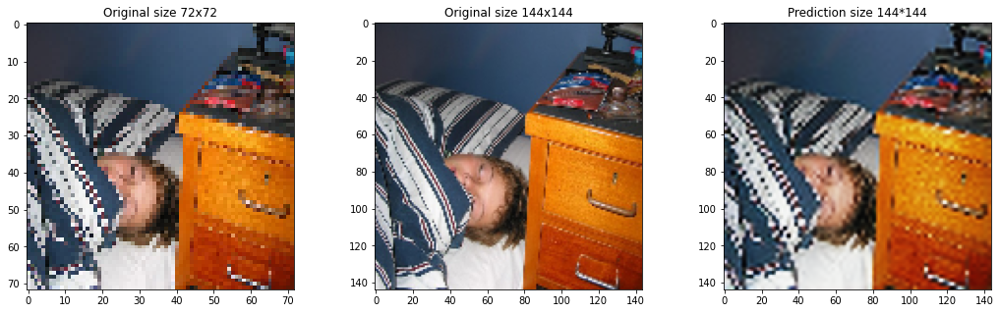

In [34]:
plot_three_images_pred(3,x2,y_mid2,pred1,0)

Prediction for large size

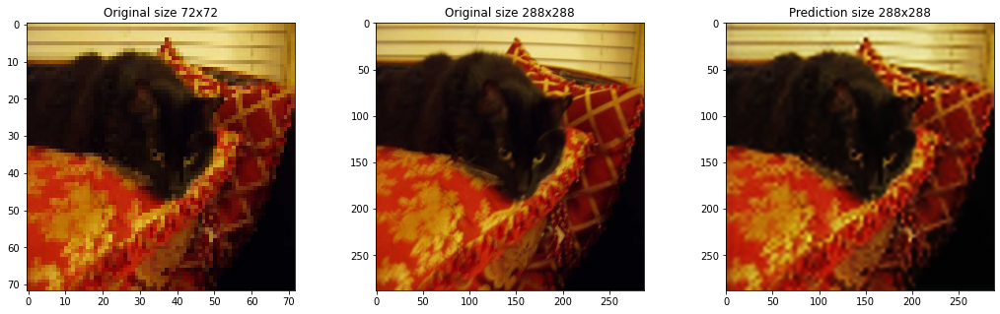

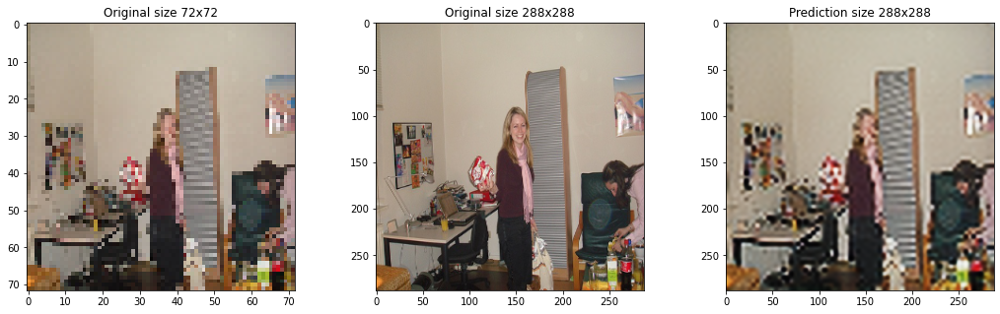

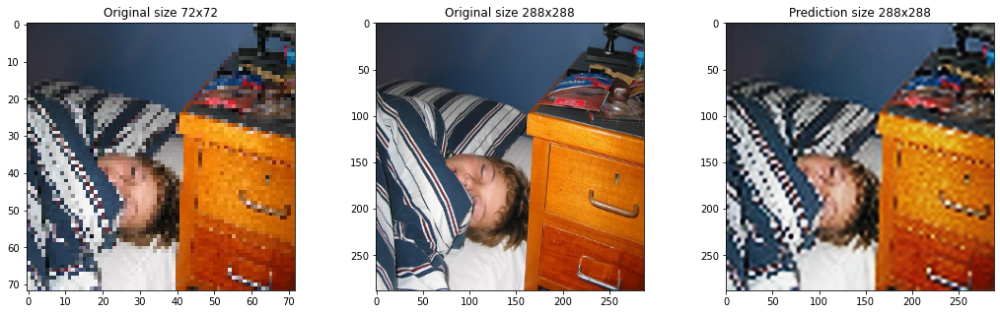

In [35]:
plot_three_images_pred(3,x2,y_large2,pred2,1)

## **Plotting PSNR and Loss of model 2 by epoch**

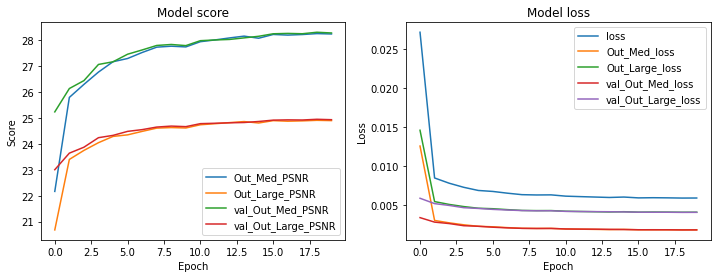

In [36]:
history_to_plot(history_2, scores, losses)

## **Gif for modle 2 predictions**

Gif for images predictions size 288x288 of model 2

In [37]:
create_gif('model_2',1,3)

Image(value=b'GIF89a \x01 \x01\x87\x00\x00\xfb\xef\xb1\xf9\xed\xac\xf8\xec\xa9\xf7\xe9\xa5\xf6\xe7\x9d\xf5\xe4…

# **Step 4: Add residual blocks into the process. Spend a moment to think, what should be the input and output of the residual-block model**


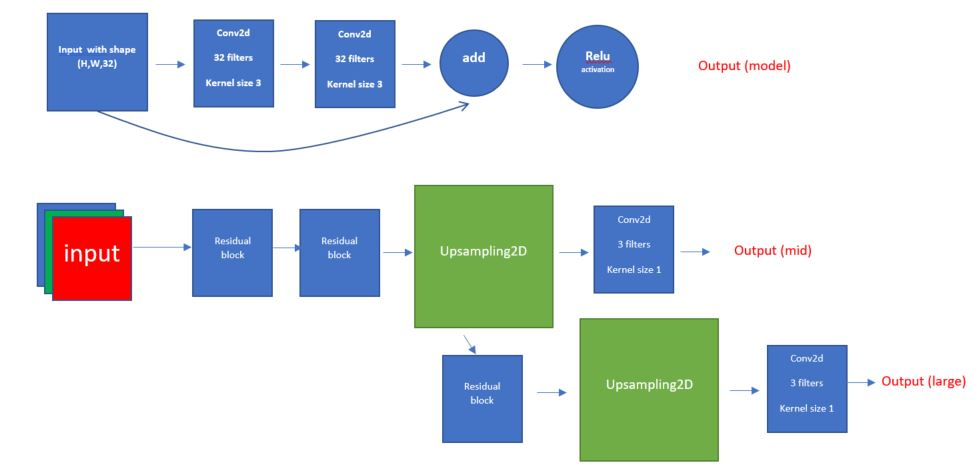

## **Model 3 architecture**

**Residual block**

In [38]:
def residual_block(cnl):
  input_shape = (None,None,cnl)  
  inputs = Input(shape=input_shape)

  x = Conv2D(cnl,(3,3),activation=LeakyReLU(alpha=0.2),padding='same')(inputs)
  x = Conv2D(cnl,(3,3),activation=LeakyReLU(alpha=0.2),padding='same')(x)
  x = add([inputs,x])
  x = LeakyReLU(alpha=0.2)(x)

  return Model(inputs,x)

**The model architecture**

In [39]:
#step 4
def get_model():
  inp = Input(shape = (None,None,3))
  x = Conv2D(32,1)(inp)
  x = Activation(LeakyReLU(alpha=0.2))(x)
  x = residual_block(32)(x)
  x = residual_block(32)(x)
  x = UpSampling2D()(x)

  y1 = Conv2D(3,1, padding='same')(x)
  y1 = Activation(LeakyReLU(alpha=0.2),name = 'Out_Med')(y1)

  x = residual_block(32)(x)
  x = UpSampling2D()(x)

  y2 = Conv2D(3,1, padding='same')(x)
  y2 = Activation(LeakyReLU(alpha=0.2),name = 'Out_Large')(y2)



  model_res = Model(inp,[y1,y2])
  if use_psnr:
    model_res.compile(loss=PSNR,optimizer='adam',metrics=['acc','mse'])
  else:
    model_res.compile(loss='mse',optimizer='adam',metrics=['acc',PSNR])
  return model_res

res_model = get_model()
res_model.summary()

Model: "model_5"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv2d_5 (Conv2D)               (None, None, None, 3 128         input_3[0][0]                    
__________________________________________________________________________________________________
activation (Activation)         (None, None, None, 3 0           conv2d_5[0][0]                   
__________________________________________________________________________________________________
model_2 (Functional)            (None, None, None, 3 18496       activation[0][0]                 
____________________________________________________________________________________________

In [40]:
history_3 = res_model.fit(UnionDataGenerator(new_images_path,16,'training'),
               callbacks=[create_callbacks('model_3')],
               steps_per_epoch = len(file_list)*0.8//16,
               validation_data = UnionDataGenerator(new_images_path,16,'validation'),
               validation_steps = len(file_list)*0.2//16,
               epochs = EPOCHS_NUM)

Found 4009 images belonging to 1 classes.
Found 4009 images belonging to 1 classes.
Found 4009 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Epoch 1/20
250/250 [==============================] - 93s 366ms/step - loss: 0.0417 - Out_Med_loss: 0.0169 - Out_Large_loss: 0.0248 - Out_Med_acc: 0.6235 - Out_Med_PSNR: 20.9252 - Out_Large_acc: 0.6112 - Out_Large_PSNR: 19.4405 - val_loss: 0.0087 - val_Out_Med_loss: 0.0035 - val_Out_Large_loss: 0.0052 - val_Out_Med_acc: 0.8044 - val_Out_Med_PSNR: 25.3265 - val_Out_Large_acc: 0.7877 - val_Out_Large_PSNR: 23.7159
Epoch 2/20
250/250 [==============================] - 91s 365ms/step - loss: 0.0083 - Out_Med_loss: 0.0033 - Out_Large_loss: 0.0050 - Out_Med_acc: 0.8172 - Out_Med_PSNR: 25.5403 - Out_Large_acc: 0.7888 - Out_Large_PSNR: 23.8822 - val_loss: 0.0080 - val_Out_Med_loss: 0.0032 - val_Out_Large_loss: 0.0048 - val_Out_Med_acc: 0.8304 - va

In [41]:
pred1,pred2 = res_model.predict(x2)

## **Model 3 plotting images predictions**

Prediction for mid size with residual blocks

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


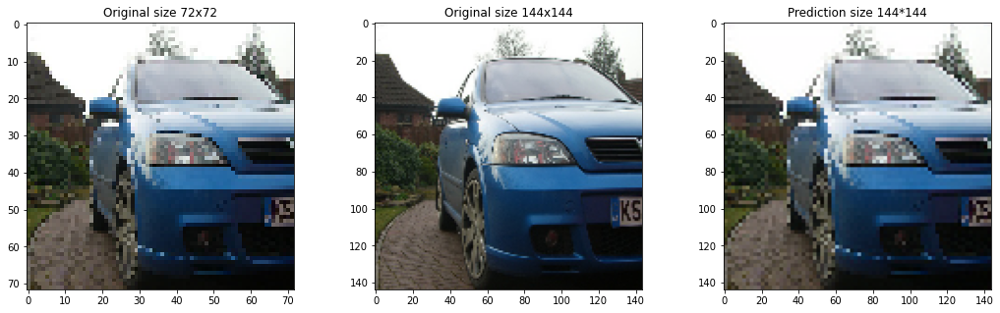

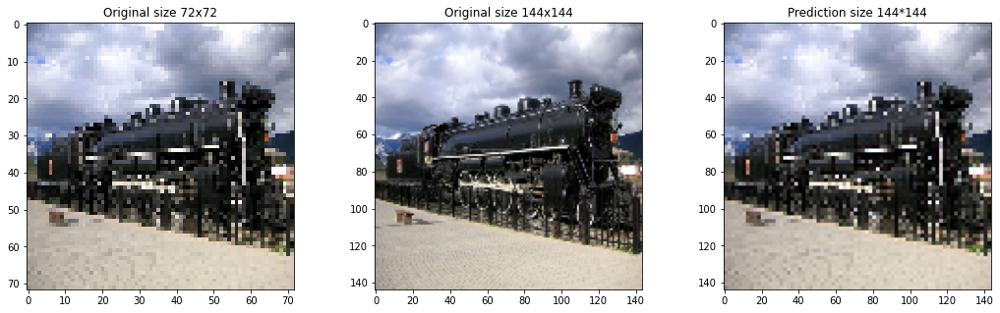

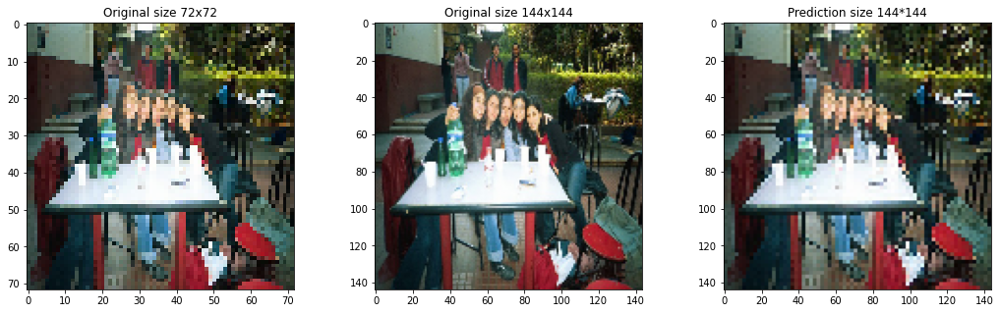

In [42]:
plot_three_images_pred(6,x2,y_mid2,pred1,0)

Prediction for large size with residual blocks

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


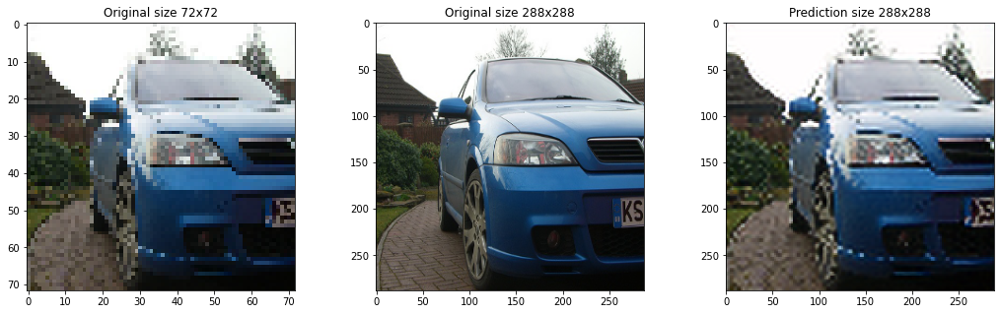

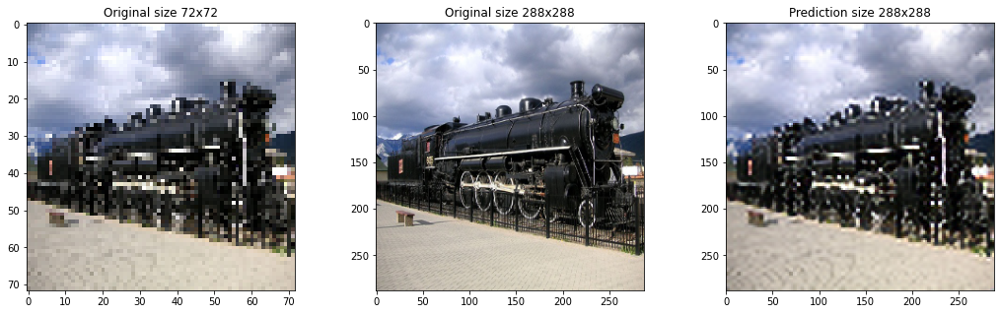

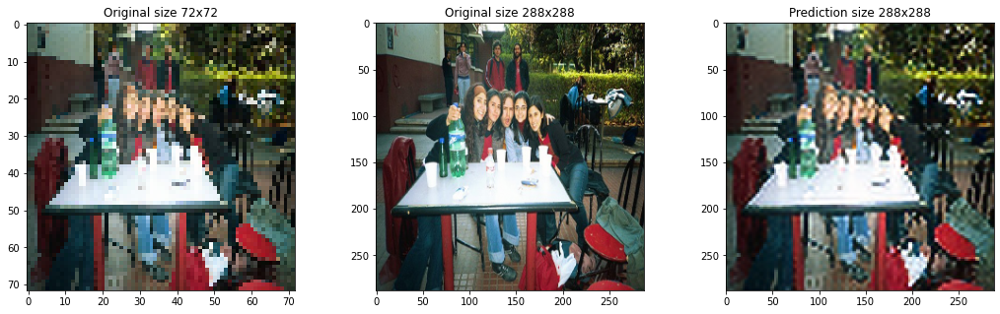

In [43]:
plot_three_images_pred(6,x2,y_large2,pred2,1)

## **Plotting PSNR and Loss of model 3 by epoch**

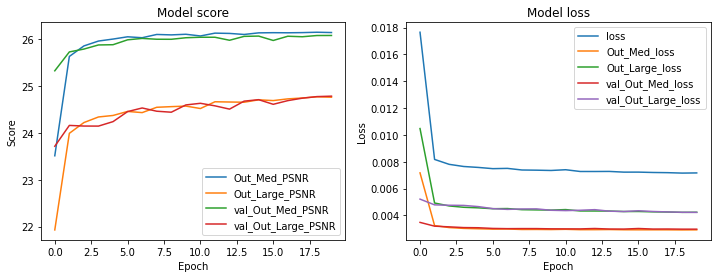

In [44]:
history_to_plot(history_3, scores, losses)

## **Gif for model 3 predictions**

Gif for images predictions size 288x288 of model 3



In [45]:
create_gif('model_3',1,6)

Image(value=b'GIF89a \x01 \x01\x87\x00\x00\xe0\xe8\xe1\xd9\xde\xd9\xdd\xdb\xd7\xd9\xd8\xd6\xd0\xd8\xd5\xd5\xd4…

## **Model 3 improvment architecture**

In [46]:
def get_model_residual2():
  inp = Input(shape = (None,None,3))
  x = Conv2D(32,1)(inp)
  x = Activation(LeakyReLU(alpha=0.2))(x)
  x = residual_block(32)(x)
  x = residual_block(32)(x)
  x = UpSampling2D()(x)

  y1 = Conv2D(3,1, padding='same')(x)
  y1 = Activation(LeakyReLU(alpha=0.2),name = 'Out_Med')(y1)

  x = residual_block(32)(x)
  x = residual_block(32)(x)
  x = residual_block(32)(x)
  
  x = UpSampling2D()(x)

  y2 = Conv2D(3,1, padding='same')(x)
  y2 = Activation(LeakyReLU(alpha=0.2),name = 'Out_Large')(y2)



  model_res2 = Model(inp,[y1,y2])
  if use_psnr:
    model_res2.compile(loss=PSNR,optimizer='adam',metrics=['acc','mse'])
  else:
    model_res2.compile(loss='mse',optimizer='adam',metrics=['acc',PSNR])
  return model_res2

res_model_2 = get_model_residual2()
res_model_2.summary()

Model: "model_11"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_7 (InputLayer)            [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv2d_14 (Conv2D)              (None, None, None, 3 128         input_7[0][0]                    
__________________________________________________________________________________________________
activation_1 (Activation)       (None, None, None, 3 0           conv2d_14[0][0]                  
__________________________________________________________________________________________________
model_6 (Functional)            (None, None, None, 3 18496       activation_1[0][0]               
___________________________________________________________________________________________

In [47]:
history_3_1 = res_model_2.fit(UnionDataGenerator(new_images_path,16,'training'),
               callbacks=[create_callbacks('model_3_1')],
               steps_per_epoch = len(file_list)*0.8//16,
               validation_data = UnionDataGenerator(new_images_path,16,'validation'),
               validation_steps = len(file_list)*0.2//16,
               epochs = EPOCHS_NUM)

Found 4009 images belonging to 1 classes.
Found 4009 images belonging to 1 classes.
Found 4009 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Epoch 1/20
250/250 [==============================] - 95s 375ms/step - loss: 0.0494 - Out_Med_loss: 0.0189 - Out_Large_loss: 0.0304 - Out_Med_acc: 0.5788 - Out_Med_PSNR: 20.7435 - Out_Large_acc: 0.6163 - Out_Large_PSNR: 19.4395 - val_loss: 0.0086 - val_Out_Med_loss: 0.0035 - val_Out_Large_loss: 0.0051 - val_Out_Med_acc: 0.7991 - val_Out_Med_PSNR: 25.2974 - val_Out_Large_acc: 0.8071 - val_Out_Large_PSNR: 23.8063
Epoch 2/20
250/250 [==============================] - 93s 372ms/step - loss: 0.0084 - Out_Med_loss: 0.0033 - Out_Large_loss: 0.0051 - Out_Med_acc: 0.8185 - Out_Med_PSNR: 25.5602 - Out_Large_acc: 0.7927 - Out_Large_PSNR: 23.8318 - val_loss: 0.0080 - val_Out_Med_loss: 0.0032 - val_Out_Large_loss: 0.0048 - val_Out_Med_acc: 0.8561 - va

In [48]:
pred1,pred2 = res_model_2.predict(x2)

## **Model 3 improvment plotting images predictions**

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


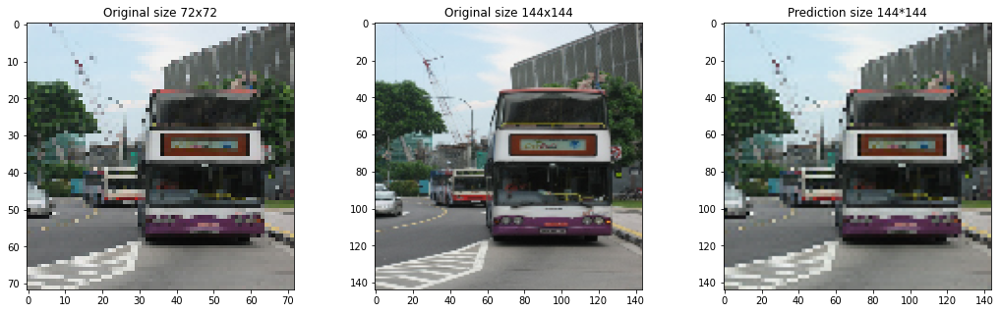

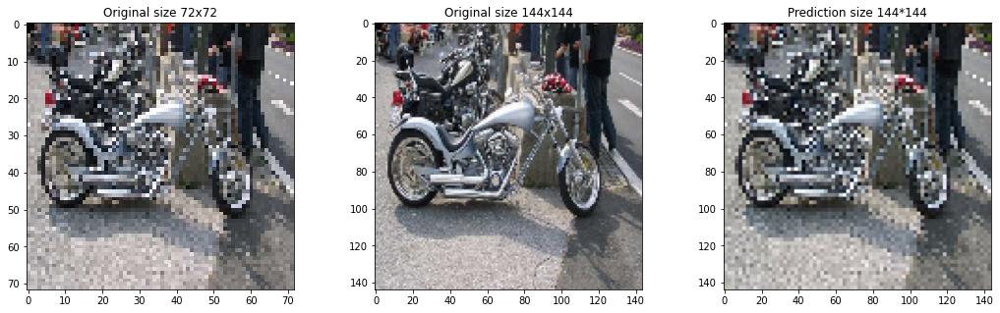

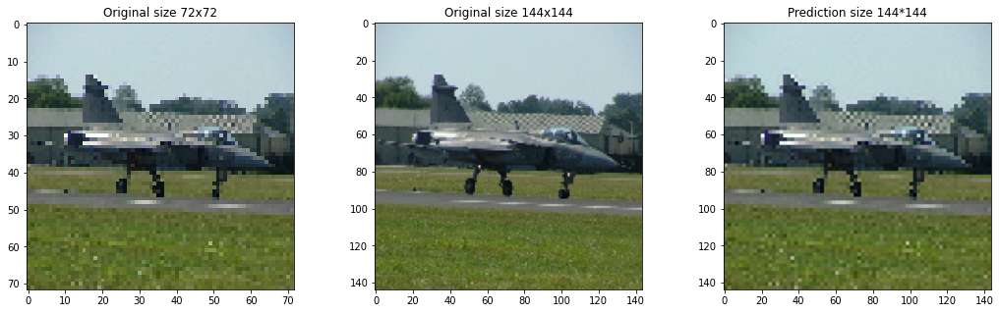

In [49]:
plot_three_images_pred(9,x2,y_mid2,pred1,0)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


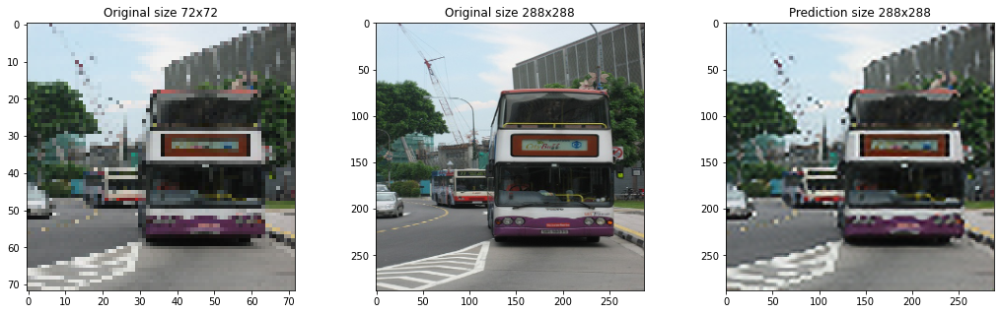

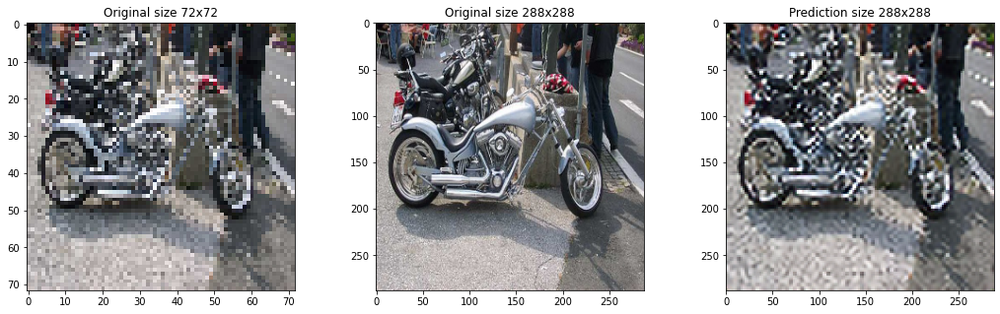

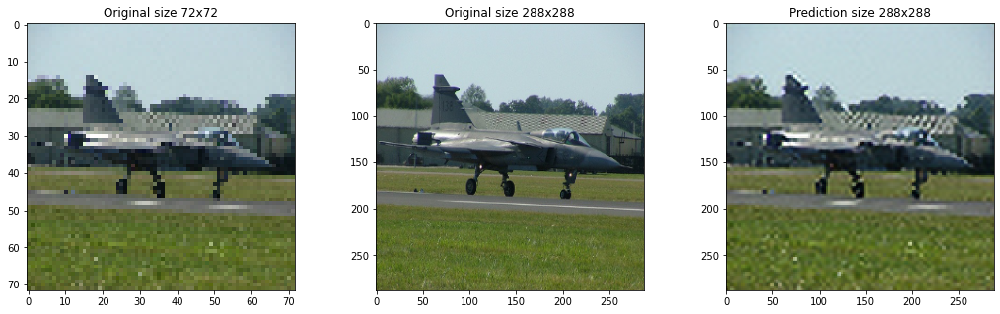

In [50]:
plot_three_images_pred(9,x2,y_large2,pred2,1)

## **Model 3 improvment plotting PSNR and Loss by epoch**

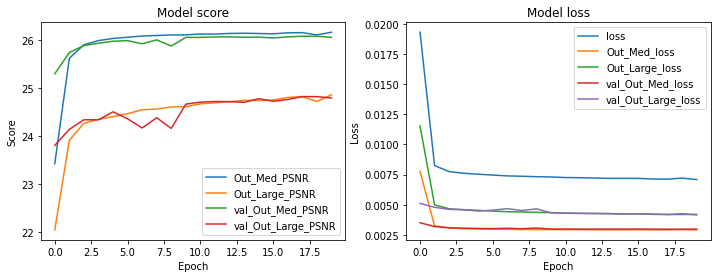

In [51]:
history_to_plot(history_3_1, scores, losses)

## **Gif for model 3 improved predictions**

In [52]:
create_gif('model_3_1',1,9)

Image(value=b'GIF89a \x01 \x01\x87\x00\x00\xe2\xe8\xe7\xce\xe2\xe2\xd8\xde\xde\xd7\xdb\xdd\xcd\xdb\xde\xd3\xd7…

# **Step 5: replace the residual blocks we defined above with a dilated (Atrous) convolutional block as described below:**


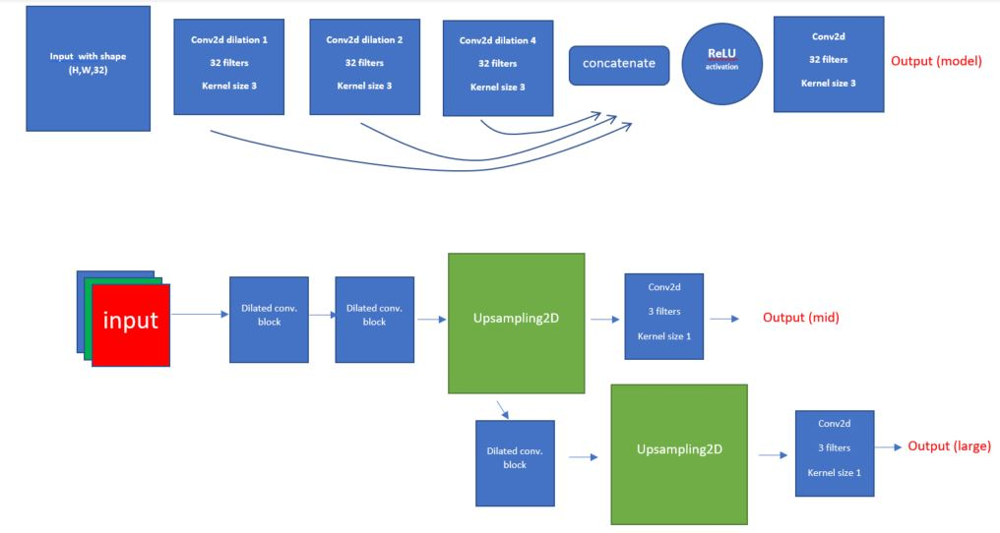

## **Model 4 architecture**

**Dilated conv block**

In [23]:
def dilated_conv(cnl):
  inp = Input(shape = (None,None,cnl))
  d1 = Conv2D(cnl,3,activation=LeakyReLU(alpha=0.2),padding='same',dilation_rate=1)(inp)
  d2 = Conv2D(cnl,3,activation=LeakyReLU(alpha=0.2),padding='same',dilation_rate=2)(inp)
  d3 = Conv2D(cnl,3,activation=LeakyReLU(alpha=0.2),padding='same',dilation_rate=4)(inp)
  c = concatenate([d1,d2,d3],axis=-1)
  a = LeakyReLU(alpha=0.2)(c)
  out = Conv2D(cnl,3,padding='same')(a)
  return Model(inp,out)

**The model architecture**

In [54]:
#step 5
def dilated_model():
  inp = Input(shape = (None,None,3))
  x= Conv2D(32,1)(inp)
  x = Activation(LeakyReLU(alpha=0.2))(x)
  x = dilated_conv(32)(x)
  x = dilated_conv(32)(x)
  x = UpSampling2D(interpolation='bilinear')(x)
  y1 = Conv2D(3,1,padding='same')(x)
  y1 = Activation('sigmoid',name = 'Out_Med')(y1)
  x = dilated_conv(32)(x)
  x = UpSampling2D(interpolation='bilinear')(x)
  y2 = Conv2D(3,1,padding='same')(x)
  y2 = Activation('sigmoid',name = 'Out_Large')(y2)
  model_del = Model(inp,[y1,y2])
  if use_psnr:
    model_del.compile(loss=PSNR,optimizer='adam',metrics=['acc','mse'])
  else:
    model_del.compile(loss='mse',optimizer='adam',metrics=['acc',PSNR])
  return model_del

model_del = dilated_model()
model_del.summary()

Model: "model_15"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_13 (InputLayer)           [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv2d_27 (Conv2D)              (None, None, None, 3 128         input_13[0][0]                   
__________________________________________________________________________________________________
activation_2 (Activation)       (None, None, None, 3 0           conv2d_27[0][0]                  
__________________________________________________________________________________________________
model_12 (Functional)           (None, None, None, 3 55424       activation_2[0][0]               
___________________________________________________________________________________________

In [55]:
history_4 = model_del.fit(UnionDataGenerator(new_images_path,16,'training'),
               callbacks=[create_callbacks('model_4')],
               steps_per_epoch = len(file_list)*0.8//16,
               validation_data = UnionDataGenerator(new_images_path,16,'validation'),
               validation_steps = len(file_list)*0.2//16,
               epochs = EPOCHS_NUM)

Found 4009 images belonging to 1 classes.
Found 4009 images belonging to 1 classes.
Found 4009 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Epoch 1/20
250/250 [==============================] - 99s 386ms/step - loss: 0.0425 - Out_Med_loss: 0.0206 - Out_Large_loss: 0.0219 - Out_Med_acc: 0.6496 - Out_Med_PSNR: 19.6714 - Out_Large_acc: 0.6074 - Out_Large_PSNR: 18.7266 - val_loss: 0.0090 - val_Out_Med_loss: 0.0034 - val_Out_Large_loss: 0.0056 - val_Out_Med_acc: 0.8108 - val_Out_Med_PSNR: 25.4392 - val_Out_Large_acc: 0.7914 - val_Out_Large_PSNR: 23.3275
Epoch 2/20
250/250 [==============================] - 96s 382ms/step - loss: 0.0083 - Out_Med_loss: 0.0031 - Out_Large_loss: 0.0052 - Out_Med_acc: 0.8103 - Out_Med_PSNR: 25.8247 - Out_Large_acc: 0.7851 - Out_Large_PSNR: 23.6247 - val_loss: 0.0072 - val_Out_Med_loss: 0.0025 - val_Out_Large_loss: 0.0047 - val_Out_Med_acc: 0.7986 - va

In [56]:
pred1,pred2 = model_del.predict(x2)

## **Model 4 plotting images predictions**

Prediction for mid size with a dilated (Atrous) convolutional block

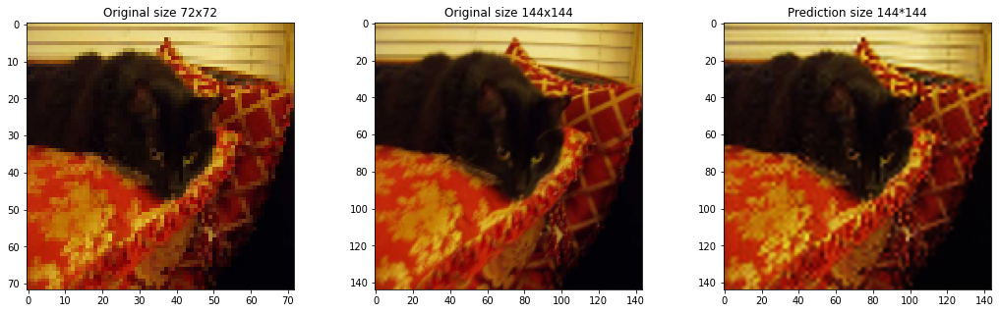

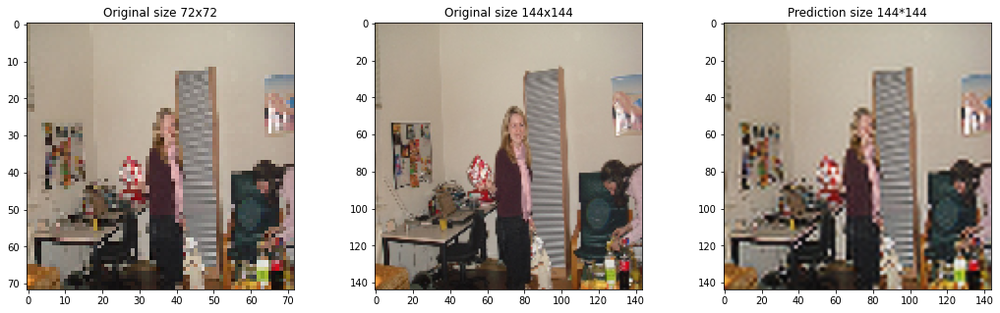

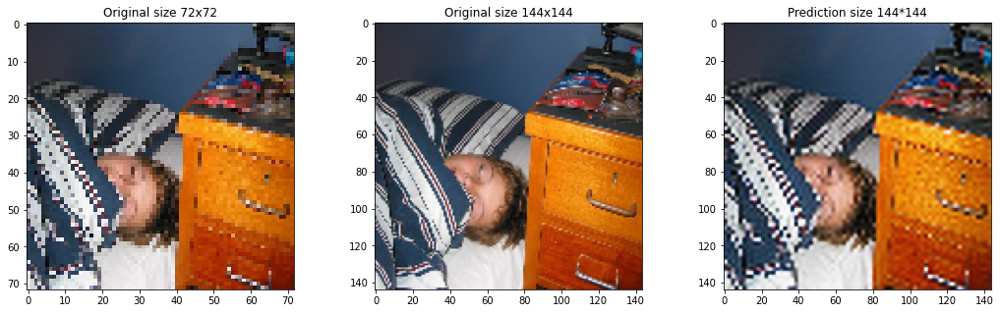

In [57]:
plot_three_images_pred(3,x2,y_mid2,pred1,0)

Prediction for large size with a dilated (Atrous) convolutional block

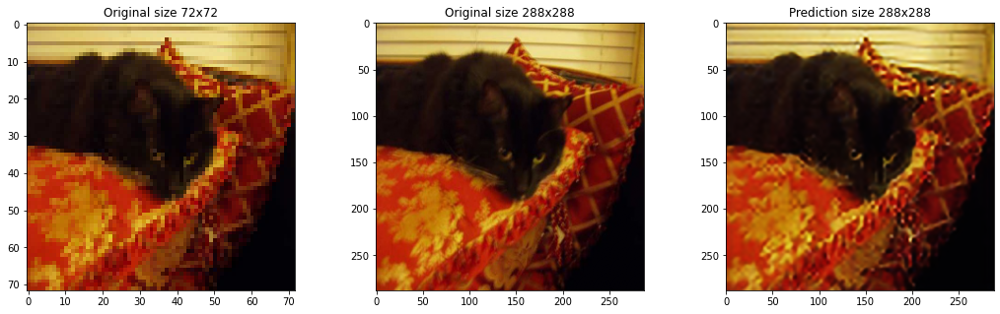

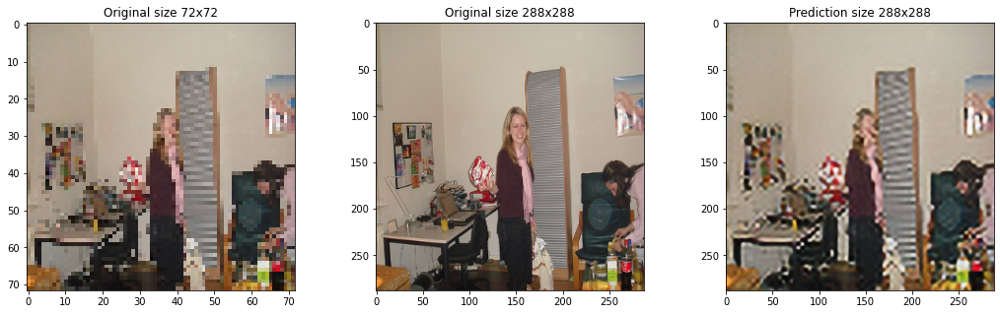

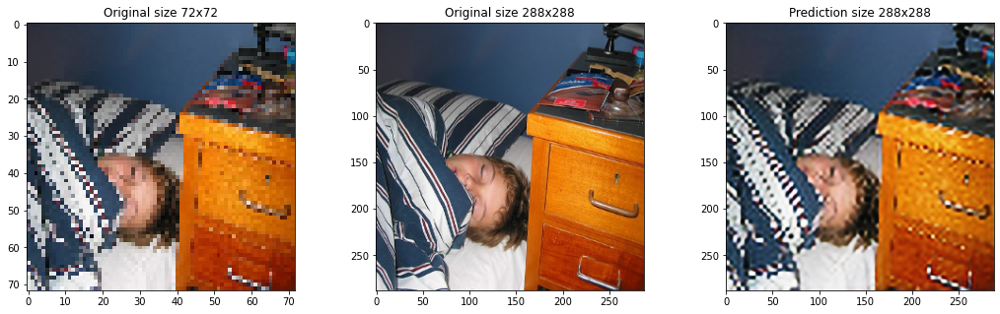

In [58]:
plot_three_images_pred(3,x2,y_large2,pred2,1)

## **Plotting PSNR and Loss of model 4 by epoch**

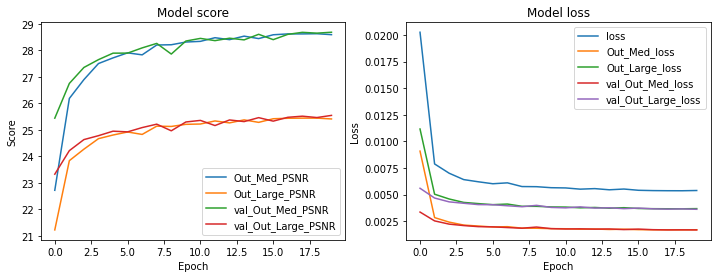

In [59]:
history_to_plot(history_4, scores, losses)

## **Gif for model 4 predictions**

Gif for images predictions size 288x288 of model 4

In [60]:
create_gif('model_4',1,3)

Image(value=b'GIF89a \x01 \x01\x87\x00\x00\xf8\xeb\x91\xf5\xe7\x8e\xf2\xe3\x8e\xf2\xe1\x84\xef\xdc\x82\xe7\xd8…

## **Model 4 improvment architecture**

In [61]:
def dilated_model_2():
  inp = Input(shape = (None,None,3))
  x= Conv2D(32,1)(inp)
  x = Activation(LeakyReLU(alpha=0.2))(x)

  x = dilated_conv(32)(x)
  x = dilated_conv(32)(x)

  x = UpSampling2D(interpolation='bilinear')(x)
  y1 = Conv2D(3,1,padding='same')(x)
  y1 = Activation('sigmoid',name = 'Out_Med')(y1)
  
  x = dilated_conv(32)(x)
  x = dilated_conv(32)(x)
  x = dilated_conv(32)(x)

  x = UpSampling2D(interpolation='bilinear')(x)
  y2 = Conv2D(3,1,padding='same')(x)
  y2 = Activation('sigmoid',name = 'Out_Large')(y2)
  model_del = Model(inp,[y1,y2])
  if use_psnr:
    model_del.compile(loss=PSNR,optimizer='adam',metrics=['acc','mse'])
  else:
    model_del.compile(loss='mse',optimizer='adam',metrics=['acc',PSNR])
  return model_del

model_del_2 = dilated_model_2()
model_del_2.summary()

Model: "model_21"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_17 (InputLayer)           [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv2d_42 (Conv2D)              (None, None, None, 3 128         input_17[0][0]                   
__________________________________________________________________________________________________
activation_3 (Activation)       (None, None, None, 3 0           conv2d_42[0][0]                  
__________________________________________________________________________________________________
model_16 (Functional)           (None, None, None, 3 55424       activation_3[0][0]               
___________________________________________________________________________________________

In [62]:
history_4_1 = model_del_2.fit(UnionDataGenerator(new_images_path,16,'training'),
               callbacks=[create_callbacks('model_4_1')],
               steps_per_epoch = len(file_list)*0.8//16,
               validation_data = UnionDataGenerator(new_images_path,16,'validation'),
               validation_steps = len(file_list)*0.2//16,
               epochs = EPOCHS_NUM)

Found 4009 images belonging to 1 classes.
Found 4009 images belonging to 1 classes.
Found 4009 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Epoch 1/20
250/250 [==============================] - 109s 424ms/step - loss: 0.0428 - Out_Med_loss: 0.0207 - Out_Large_loss: 0.0222 - Out_Med_acc: 0.6550 - Out_Med_PSNR: 19.2862 - Out_Large_acc: 0.6008 - Out_Large_PSNR: 18.3458 - val_loss: 0.0096 - val_Out_Med_loss: 0.0037 - val_Out_Large_loss: 0.0059 - val_Out_Med_acc: 0.8048 - val_Out_Med_PSNR: 25.0056 - val_Out_Large_acc: 0.7857 - val_Out_Large_PSNR: 23.1671
Epoch 2/20
250/250 [==============================] - 105s 419ms/step - loss: 0.0090 - Out_Med_loss: 0.0034 - Out_Large_loss: 0.0057 - Out_Med_acc: 0.7962 - Out_Med_PSNR: 25.3665 - Out_Large_acc: 0.7679 - Out_Large_PSNR: 23.2728 - val_loss: 0.0080 - val_Out_Med_loss: 0.0028 - val_Out_Large_loss: 0.0052 - val_Out_Med_acc: 0.8184 - 

In [63]:
pred1,pred2 = model_del_2.predict(x2)

## **Model 4 improvment plotting images predictions**

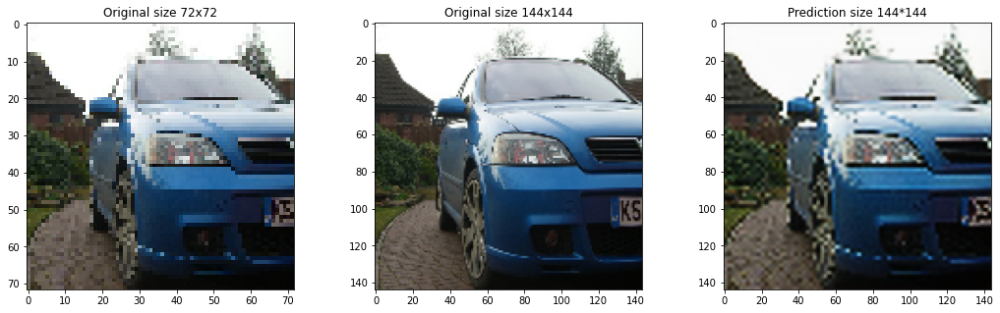

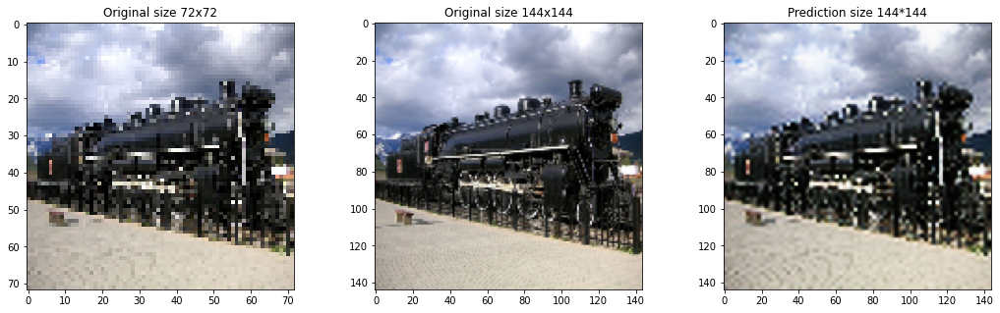

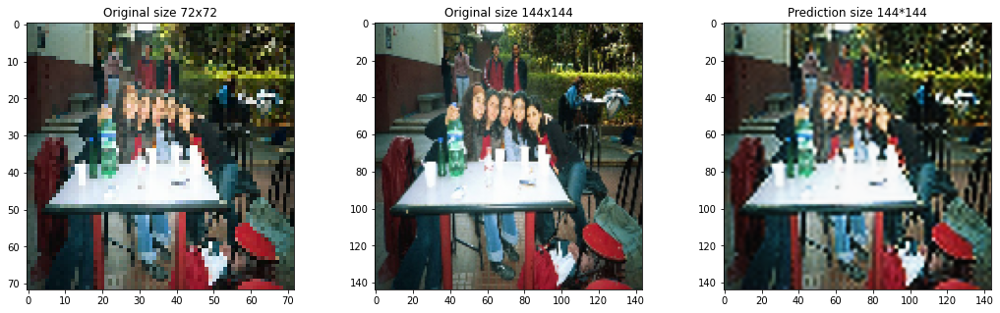

In [64]:
plot_three_images_pred(6,x2,y_mid2,pred1,0)

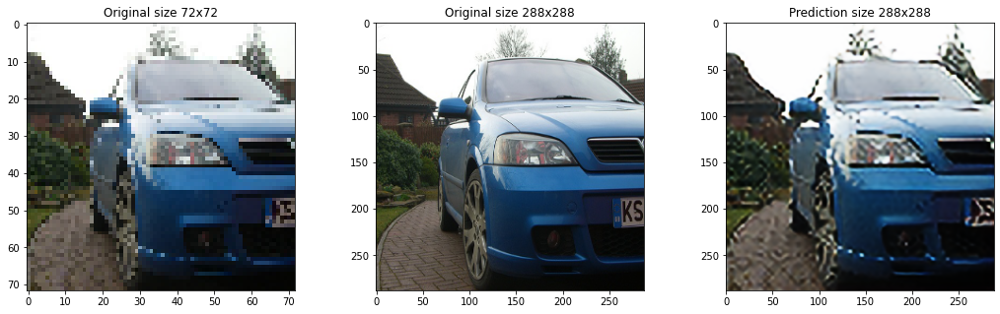

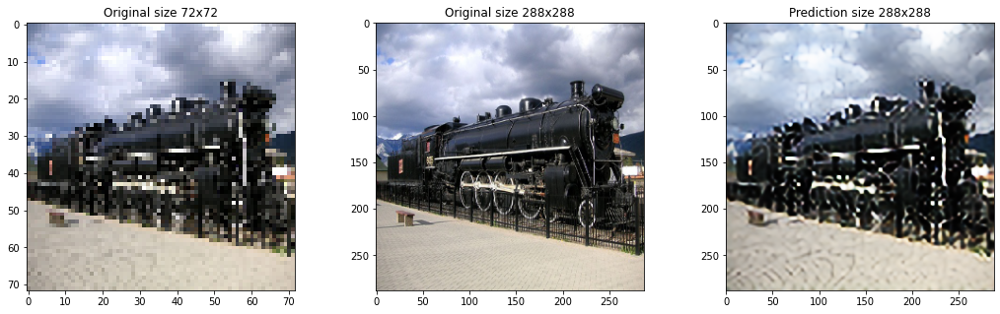

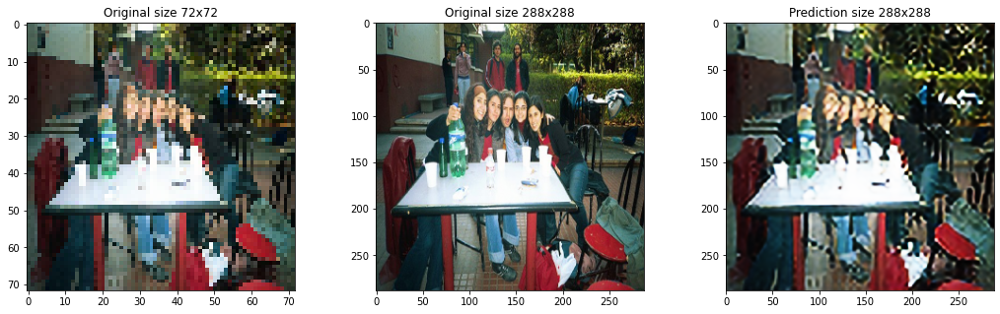

In [65]:
plot_three_images_pred(6,x2,y_large2,pred2,1)

## **Model 4 improvment plotting PSNR and Loss by epoch**

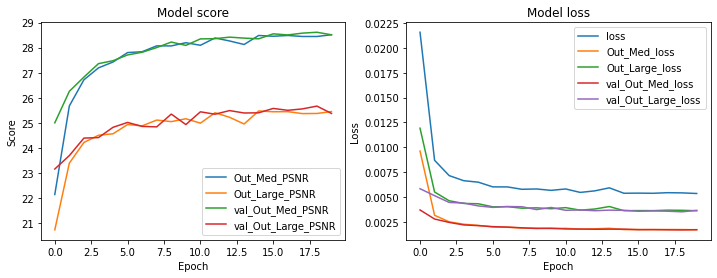

In [66]:
history_to_plot(history_4_1, scores, losses)

## **Gif for model 4 improved predictions**

In [67]:
create_gif('model_4_1',1,6)

Image(value=b'GIF89a \x01 \x01\x87\x00\x00\xfe\xfe\xfd\xfe\xfd\xfd\xfd\xfd\xfe\xfd\xfd\xfd\xfe\xfd\xfc\xfc\xfd…

# **Step 6: Add pretrained network (either efficientnet / resnet or any other) feature extractor to the network (note that the input to the network is only being read once)**


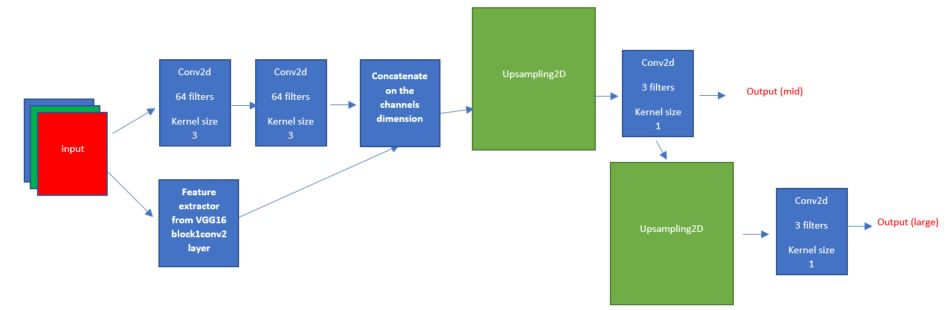

## **Load VGG16 model**

In [26]:
# step 6
from tensorflow.keras.applications.vgg16 import VGG16

In [27]:
vgg = VGG16(weights = 'imagenet', include_top = False)
fe_model = Model(vgg.input,vgg.layers[2].output)
fe_model.summary()

58892288/58889256 [==============================] - 1s 0us/step
Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, None, None, 3)]   0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, None, None, 64)    1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, None, None, 64)    36928     
Total params: 38,720
Trainable params: 38,720
Non-trainable params: 0
_________________________________________________________________


In [28]:
for l in fe_model.layers:
  l.trainable = False

In [29]:
fe_model.compile(loss = 'mse',optimizer='adam')
fe_model.predict(x).shape

(100, 72, 72, 64)

## **Model 5 architecture**

In [72]:
#step 6
def get_model_with_vgg(): 
  inp = Input(shape=(None,None,3))

  x = Conv2D(64,3,activation=Activation(LeakyReLU(alpha=0.2)), padding = 'same')(inp)
  x = Conv2D(64,3,activation=Activation(LeakyReLU(alpha=0.2)), padding = 'same')(x)

  y = fe_model(inp)
  x = concatenate([x,y],axis=-1)

  x = UpSampling2D(interpolation='bilinear')(x)
  y1 =Conv2D(3,1, padding='same')(x)
  y1 = Activation('sigmoid',name = 'Out_Med')(y1)

  x = Conv2D(32,1)(x)
  x = UpSampling2D(interpolation='bilinear')(x)

  y2 = Conv2D(3,1,padding='same')(x)
  y2 = Activation('sigmoid',name = 'Out_Large')(y2)

  model_with_vgg = Model(inp,[y1,y2])
  if use_psnr:
    model_with_vgg.compile(loss=PSNR,optimizer='adam',metrics=['acc','mse'])
  else:
    model_with_vgg.compile(loss='mse',optimizer='adam',metrics=['acc',PSNR])
  return model_with_vgg


In [73]:
model_with_vgg = get_model_with_vgg()
model_with_vgg.summary()

Model: "model_23"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_24 (InputLayer)           [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv2d_65 (Conv2D)              (None, None, None, 6 1792        input_24[0][0]                   
__________________________________________________________________________________________________
conv2d_66 (Conv2D)              (None, None, None, 6 36928       conv2d_65[0][0]                  
__________________________________________________________________________________________________
model_22 (Functional)           (None, None, None, 6 38720       input_24[0][0]                   
___________________________________________________________________________________________

In [74]:
history_5 = model_with_vgg.fit(UnionDataGenerator(new_images_path,16,'training'),
               callbacks=[create_callbacks('model_5')],
               steps_per_epoch = len(file_list)*0.8//16,
               validation_data = UnionDataGenerator(new_images_path,16,'validation'),
               validation_steps = len(file_list)*0.2//16,
               epochs = EPOCHS_NUM)

Found 4009 images belonging to 1 classes.
Found 4009 images belonging to 1 classes.
Found 4009 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Epoch 1/20
250/250 [==============================] - 93s 366ms/step - loss: 0.1670 - Out_Med_loss: 0.0942 - Out_Large_loss: 0.0728 - Out_Med_acc: 0.4379 - Out_Med_PSNR: 13.1442 - Out_Large_acc: 0.5957 - Out_Large_PSNR: 14.9270 - val_loss: 0.0137 - val_Out_Med_loss: 0.0067 - val_Out_Large_loss: 0.0069 - val_Out_Med_acc: 0.6972 - val_Out_Med_PSNR: 22.1309 - val_Out_Large_acc: 0.7584 - val_Out_Large_PSNR: 22.2254
Epoch 2/20
250/250 [==============================] - 91s 366ms/step - loss: 0.0124 - Out_Med_loss: 0.0058 - Out_Large_loss: 0.0066 - Out_Med_acc: 0.6949 - Out_Med_PSNR: 22.8101 - Out_Large_acc: 0.7474 - Out_Large_PSNR: 22.4902 - val_loss: 0.0103 - val_Out_Med_loss: 0.0044 - val_Out_Large_loss: 0.0059 - val_Out_Med_acc: 0.7475 - va

In [75]:
pred1,pred2 = model_with_vgg.predict(x2)

## **Model 5 plotting images predictions**

Prediction for mid size with a vgg feature extractor

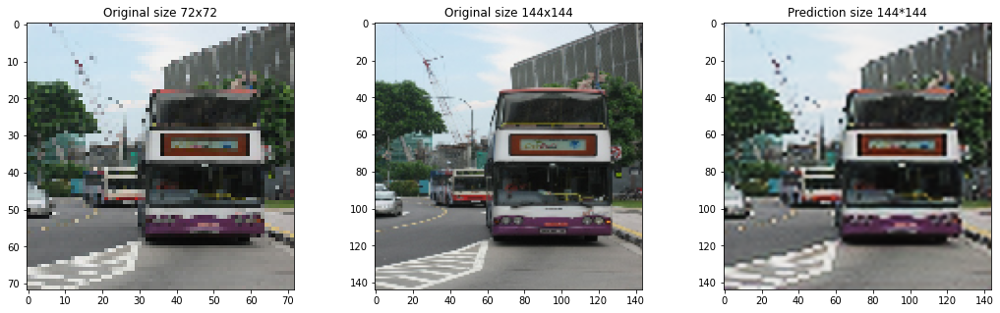

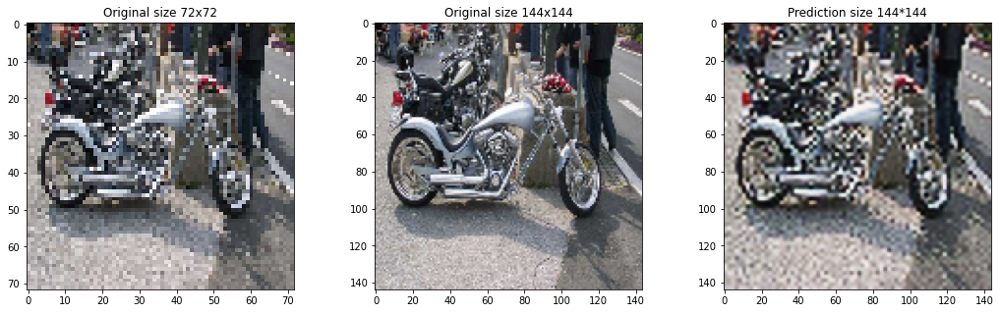

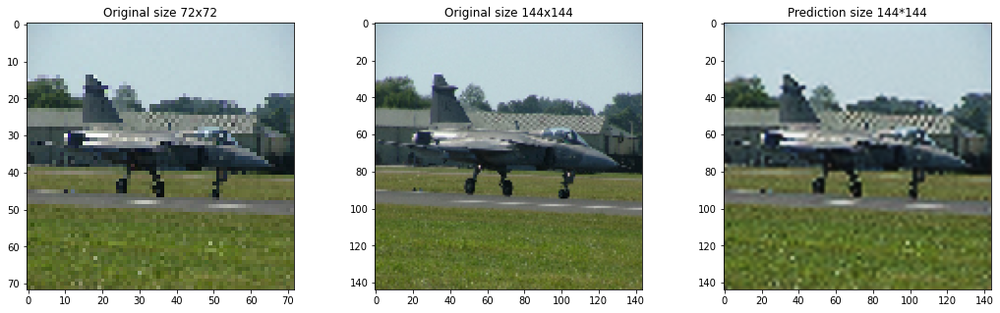

In [76]:
plot_three_images_pred(9,x2,y_mid2,pred1,0)

Prediction for large size with a vgg feature extractor

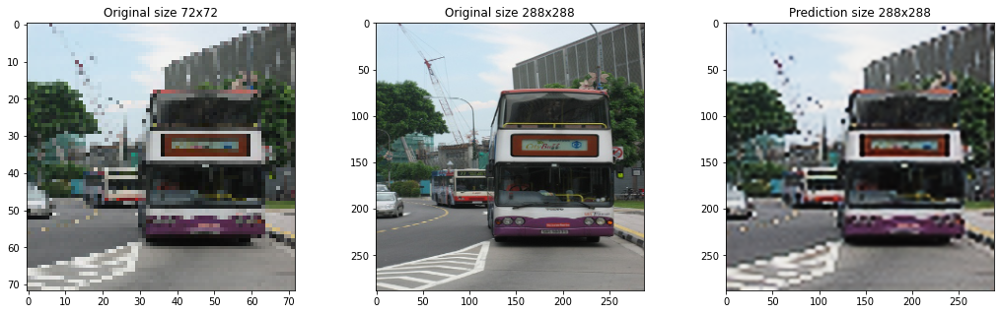

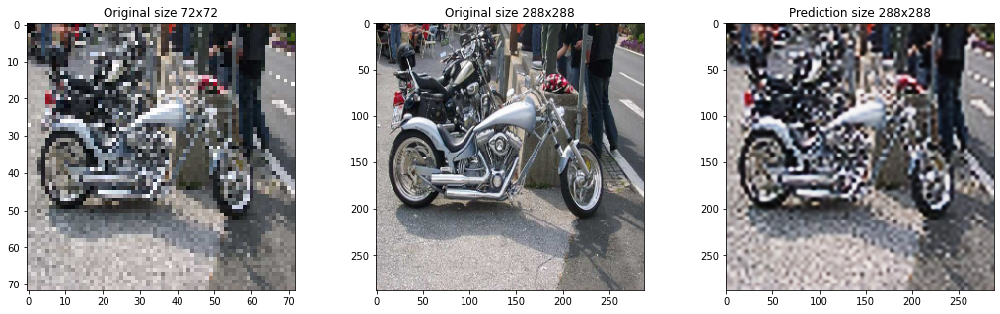

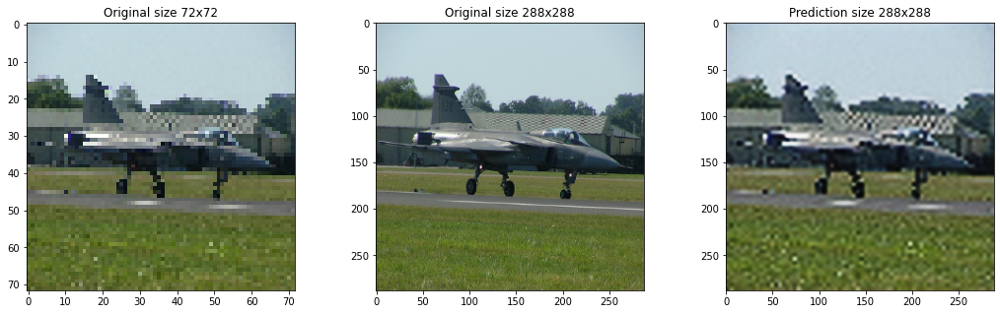

In [77]:
plot_three_images_pred(9,x2,y_large2,pred2,1)

## **Plotting PSNR and Loss of model 5 by epoch**

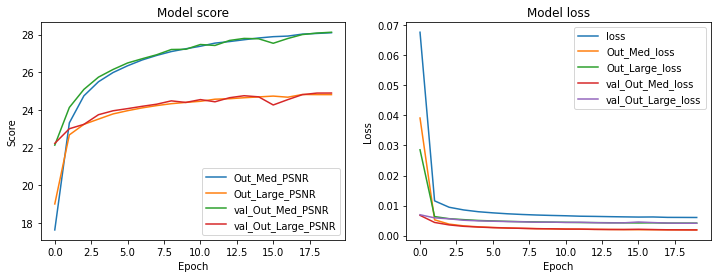

In [78]:
history_to_plot(history_5, scores, losses)

## **Gif for model 5 predictions**

Gif for images predictions size 288x288 of model 5

In [79]:
create_gif('model_5',1,9)

Image(value=b'GIF89a \x01 \x01\x87\x00\x00\xed\xf0\xf2\xec\xec\xe9\xeb\xeb\xeb\xec\xea\xee\xdf\xf2\xf0\xdf\xed…

## **Model 5 improvment architecture**

In [80]:
def get_model_with_vgg_v2():

  inp = Input(shape=(None,None,3))
  x1 = Conv2D(64,8,activation=Activation(LeakyReLU(alpha=0.2)), padding = 'same')(inp)
  x1 = dilated_conv(64)(x1)
  x1 = dilated_conv(64)(x1)

  x2 = Conv2D(64,4,activation=Activation(LeakyReLU(alpha=0.2)), padding = 'same')(inp)
  x2 = dilated_conv(64)(x2)
  x2 = dilated_conv(64)(x2)

  x3 = Conv2D(64,2,activation=Activation(LeakyReLU(alpha=0.2)), padding = 'same')(inp)
  x3 = dilated_conv(64)(x3)
  x3 = dilated_conv(64)(x3)


  y = fe_model(inp)
  x = concatenate([x1,x2,x3,y],axis=-1)

  x = UpSampling2D(interpolation='bilinear')(x)

  y1 =Conv2D(3,1, padding='same')(x)
  y1 = Activation('sigmoid',name = 'Out_Med')(y1)

  x = Conv2D(64,1)(x)
  
  x = UpSampling2D(interpolation='bilinear')(x)

  y2 = Conv2D(3,1,padding='same')(x)
  y2 = Activation('sigmoid',name = 'Out_Large')(y2)

  model_with_vgg_v2 = Model(inp,[y1,y2])
  if use_psnr:
    model_with_vgg_v2.compile(loss=PSNR,optimizer='adam',metrics=['acc','mse'])
  else:
    model_with_vgg_v2.compile(loss='mse',optimizer='adam',metrics=['acc',PSNR])
  return model_with_vgg_v2

In [81]:
model_with_vgg_v2 = get_model_with_vgg_v2()
model_with_vgg_v2.summary()

Model: "model_30"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_25 (InputLayer)           [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv2d_70 (Conv2D)              (None, None, None, 6 12352       input_25[0][0]                   
__________________________________________________________________________________________________
conv2d_79 (Conv2D)              (None, None, None, 6 3136        input_25[0][0]                   
__________________________________________________________________________________________________
conv2d_88 (Conv2D)              (None, None, None, 6 832         input_25[0][0]                   
___________________________________________________________________________________________

In [82]:
history_5_1 = model_with_vgg_v2.fit(UnionDataGenerator(new_images_path,16,'training'),
               callbacks=[create_callbacks('model_5_1')],
               steps_per_epoch = len(file_list)*0.8//16,
               validation_data = UnionDataGenerator(new_images_path,16,'validation'),
               validation_steps = len(file_list)*0.2//16,
               epochs = EPOCHS_NUM)

Found 4009 images belonging to 1 classes.
Found 4009 images belonging to 1 classes.
Found 4009 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Epoch 1/20
250/250 [==============================] - 117s 453ms/step - loss: 0.0508 - Out_Med_loss: 0.0264 - Out_Large_loss: 0.0245 - Out_Med_acc: 0.5857 - Out_Med_PSNR: 19.3277 - Out_Large_acc: 0.6333 - Out_Large_PSNR: 18.9359 - val_loss: 0.0087 - val_Out_Med_loss: 0.0033 - val_Out_Large_loss: 0.0054 - val_Out_Med_acc: 0.7274 - val_Out_Med_PSNR: 25.4622 - val_Out_Large_acc: 0.7828 - val_Out_Large_PSNR: 23.5086
Epoch 2/20
250/250 [==============================] - 112s 449ms/step - loss: 0.0082 - Out_Med_loss: 0.0030 - Out_Large_loss: 0.0052 - Out_Med_acc: 0.7750 - Out_Med_PSNR: 25.9554 - Out_Large_acc: 0.7980 - Out_Large_PSNR: 23.6671 - val_loss: 0.0070 - val_Out_Med_loss: 0.0024 - val_Out_Large_loss: 0.0045 - val_Out_Med_acc: 0.7688 - 

In [83]:
pred1,pred2 = model_with_vgg_v2.predict(x2)

## **Model 5 improvment plotting images predictions**

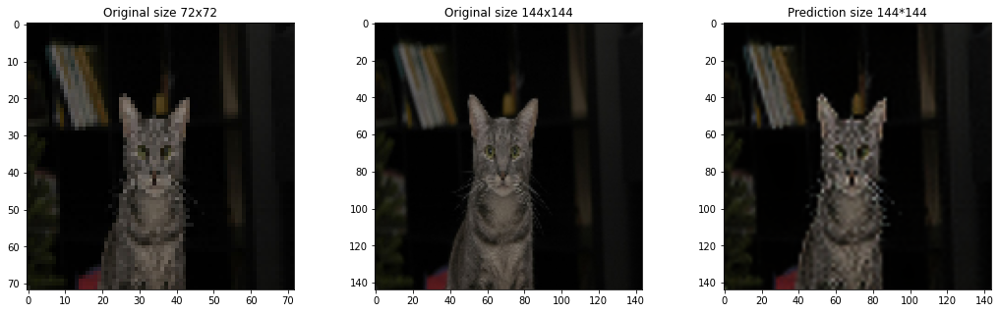

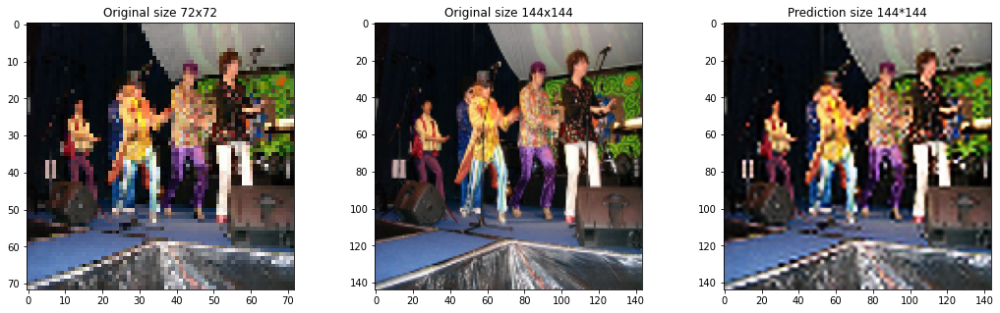

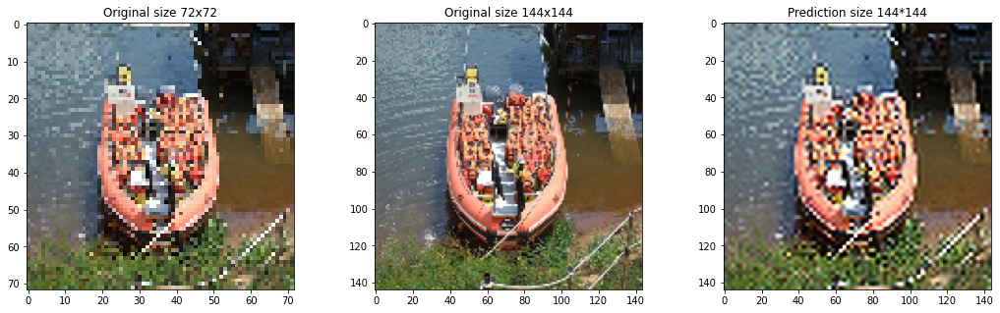

In [84]:
plot_three_images_pred(0,x2,y_mid2,pred1,0)

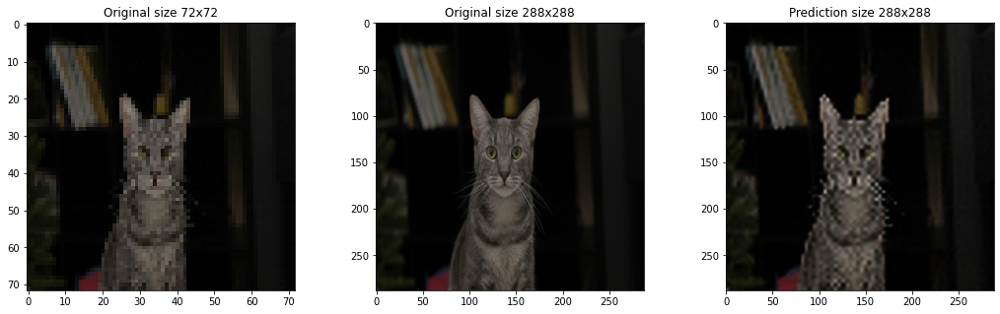

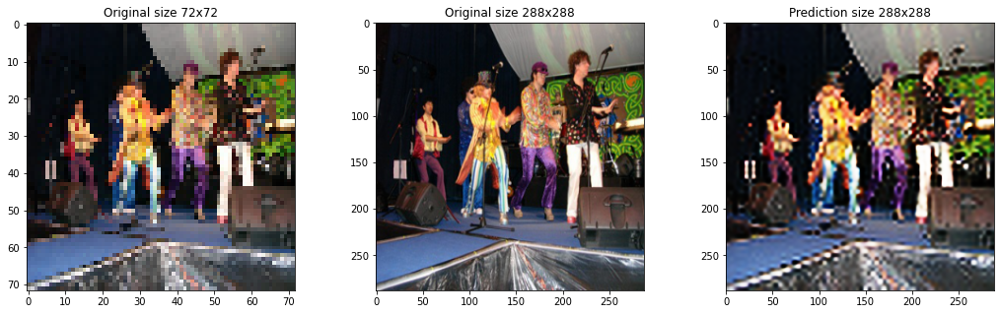

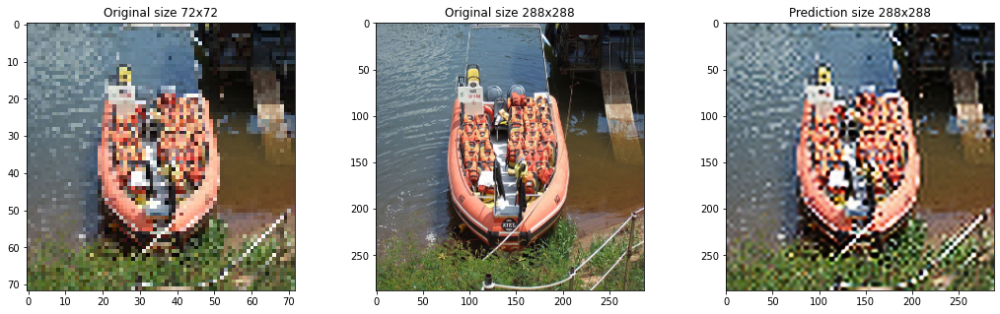

In [85]:
plot_three_images_pred(0,x2,y_large2,pred2,1)

## **Model 5 improvment plotting PSNR and Loss by epoch**

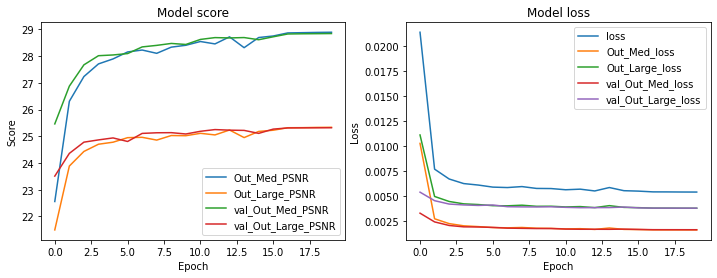

In [86]:
history_to_plot(history_5_1, scores, losses)

## **Gif for model 5 improved predictions**

In [87]:
create_gif('model_5_1',1,0)

Image(value=b'GIF89a \x01 \x01\x87\x00\x00\xc8\xc3\xa7\xb4\xae\x98\xaf\xa3\x8f\xa2\xa1\x8b\xa6\x99\x84\x9f\x96…

# **Step 7: replace the Upsampling2D layer with tf.depth_to_space with parameters (x,scale). Note that the number of filters in the preceding layer (num of input channels to the tf.depth_to_space) should be divisible by (scale^2)**


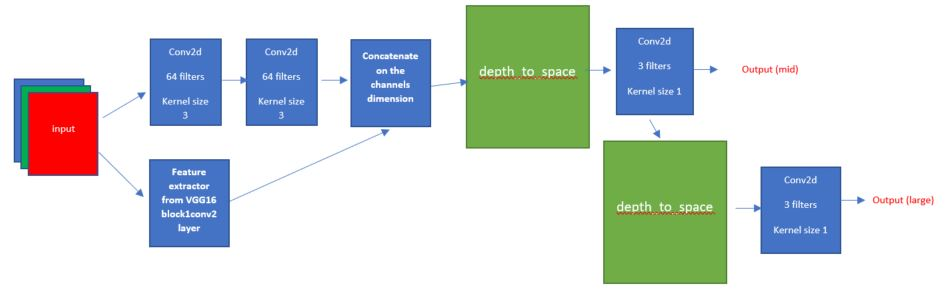

## **Model 6 architecture**

In [30]:
#step 7
def get_model_depth_to_space(): 
  inp = Input(shape=(None,None,3))

  x = Conv2D(64,3,activation=Activation(LeakyReLU(alpha=0.2)), padding = 'same')(inp)
  x = Conv2D(64,3,activation=Activation(LeakyReLU(alpha=0.2)), padding = 'same')(x)

  y = fe_model(inp)
  x = concatenate([x,y],axis=-1)

  x = tf.nn.depth_to_space(x,2)
  y1 =Conv2D(3,1, padding='same')(x)
  y1 = Activation('sigmoid',name = 'Out_Med')(y1)

  x = Conv2D(32,1)(x)
  x = tf.nn.depth_to_space(x,2)

  y2 = Conv2D(3,1,padding='same')(x)
  y2 = Activation('sigmoid',name = 'Out_Large')(y2)

  model_with_dts = Model(inp,[y1,y2])
  if use_psnr:
    model_with_dts.compile(loss=PSNR,optimizer='adam',metrics=['acc','mse'])
  else:
    model_with_dts.compile(loss='mse',optimizer='adam',metrics=['acc',PSNR])
  return model_with_dts


In [31]:
model_with_dts = get_model_depth_to_space()
model_with_dts.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, None, None, 6 1792        input_2[0][0]                    
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, None, None, 6 36928       conv2d[0][0]                     
__________________________________________________________________________________________________
model (Functional)              (None, None, None, 6 38720       input_2[0][0]                    
____________________________________________________________________________________________

In [32]:
history_6 = model_with_dts.fit(UnionDataGenerator(new_images_path,16,'training'),
               callbacks=[create_callbacks('model_6')],
               steps_per_epoch = len(file_list)*0.8//16,
               validation_data = UnionDataGenerator(new_images_path,16,'validation'),
               validation_steps = len(file_list)*0.2//16,
               epochs = EPOCHS_NUM)

Found 4009 images belonging to 1 classes.
Found 4009 images belonging to 1 classes.
Found 4009 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Epoch 1/20
250/250 [==============================] - 418s 2s/step - loss: 0.2117 - Out_Med_loss: 0.1224 - Out_Large_loss: 0.0893 - Out_Med_acc: 0.4804 - Out_Med_PSNR: 9.7628 - Out_Large_acc: 0.4507 - Out_Large_PSNR: 11.0107 - val_loss: 0.0665 - val_Out_Med_loss: 0.0373 - val_Out_Large_loss: 0.0292 - val_Out_Med_acc: 0.6291 - val_Out_Med_PSNR: 14.5247 - val_Out_Large_acc: 0.6126 - val_Out_Large_PSNR: 15.6137
Epoch 2/20
250/250 [==============================] - 410s 2s/step - loss: 0.0548 - Out_Med_loss: 0.0314 - Out_Large_loss: 0.0233 - Out_Med_acc: 0.6433 - Out_Med_PSNR: 15.2846 - Out_Large_acc: 0.6305 - Out_Large_PSNR: 16.6445 - val_loss: 0.0377 - val_Out_Med_loss: 0.0220 - val_Out_Large_loss: 0.0157 - val_Out_Med_acc: 0.6804 - val_Out

In [33]:
pred1,pred2 = model_with_dts.predict(x2)

## **Model 6 plotting images predictions**

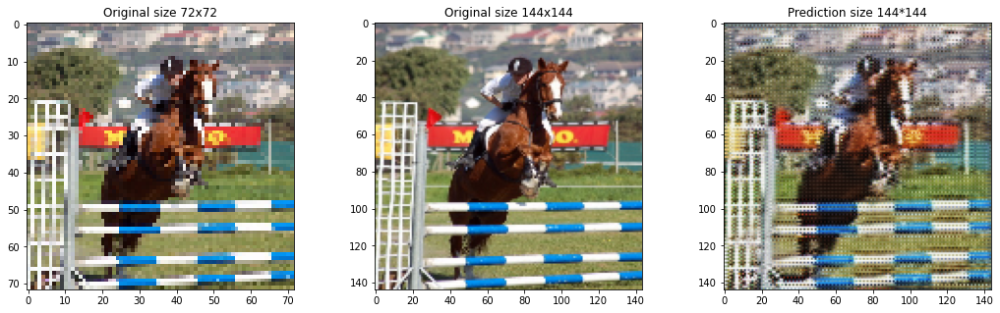

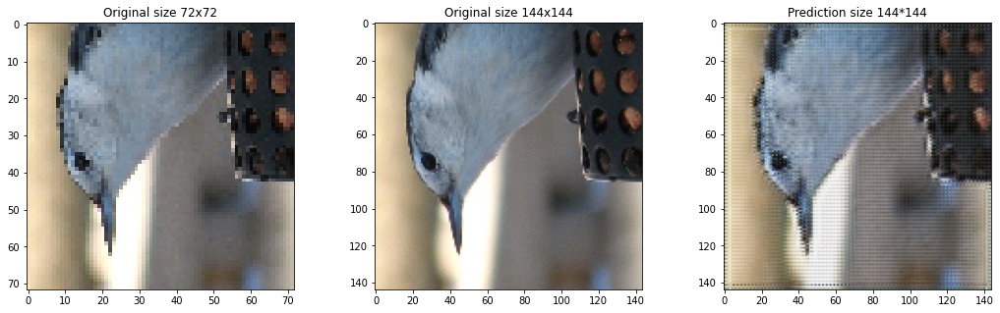

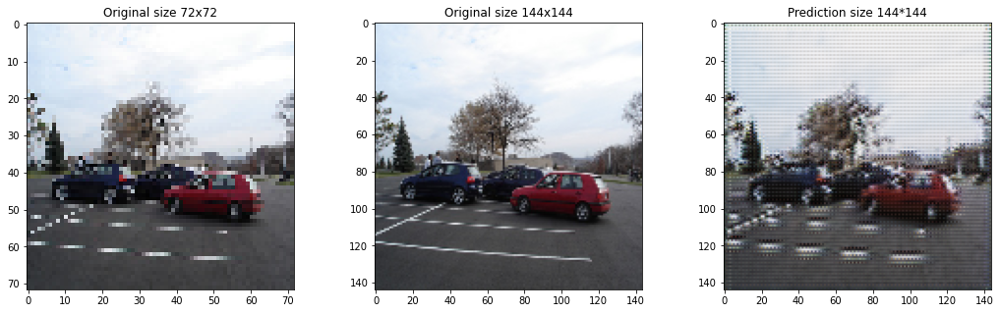

In [34]:
plot_three_images_pred(6,x2,y_mid2,pred1,0)

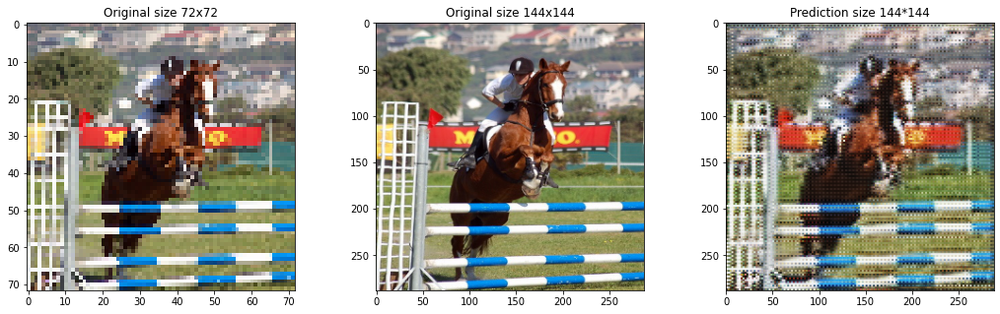

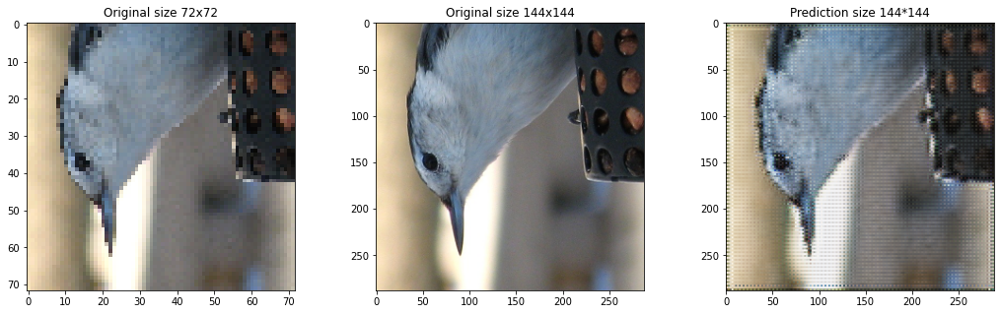

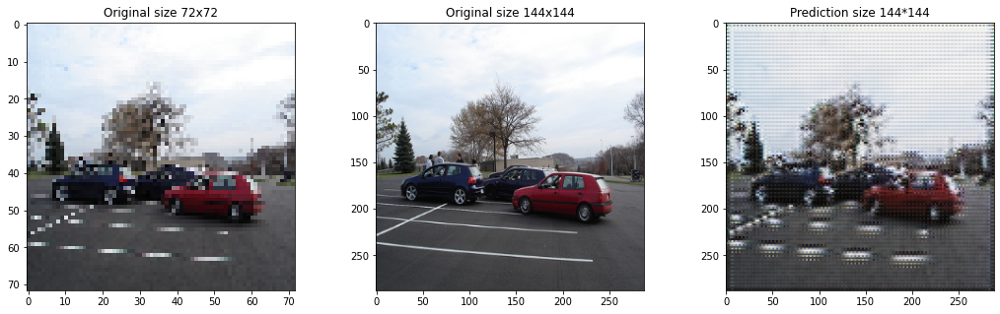

In [35]:
plot_three_images_pred(6,x2,y_large2,pred2,0)

Plotting PSNR and Loss of model 6 by epoch

## **Plotting PSNR and Loss of model 6 by epoch**

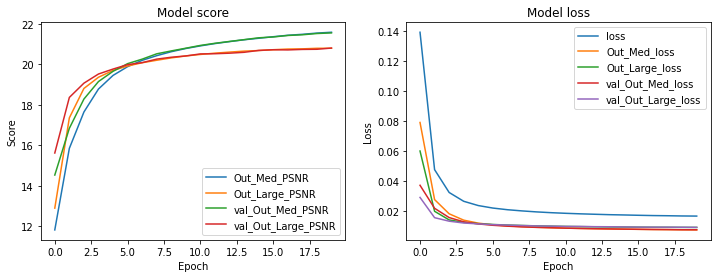

In [36]:
history_to_plot(history_6, scores, losses)

## **Gif for model 6 predictions**

Gif for images predictions size 288x288 of model 6

In [37]:
create_gif('model_6',1,6)

Image(value=b'GIF89a \x01 \x01\x87\x00\x00\xef\xec\xea\xe9\xea\xe7\xe7\xe4\xe3\xeb\xe4\xd5\xe6\xdc\xd1\xdc\xe1…

## **Model 6 improvment architecture**

In [24]:
def get_model_depth_to_space_v2(): 
  inp = Input(shape=(None,None,3))

  x = Conv2D(32,1)(inp)
  x = Activation(LeakyReLU(alpha=0.2))(x)

  x = dilated_conv(32)(x)
  x = dilated_conv(32)(x)

  # y = fe_model(inp)
  # x = concatenate([x,y],axis=-1)

  x = tf.nn.depth_to_space(x,2)
  y1 =Conv2D(3,1, padding='same')(x)
  y1 = Activation('sigmoid',name = 'Out_Med')(y1)

  x = Conv2D(32,1)(x)

  x = dilated_conv(32)(x)


  x = tf.nn.depth_to_space(x,2)



  y2 = Conv2D(3,1,padding='same')(x)
  y2 = Activation('sigmoid',name = 'Out_Large')(y2)

  model_with_dts_2 = Model(inp,[y1,y2])
  if use_psnr:
    model_with_dts_2.compile(loss=PSNR,optimizer='adam',metrics=['acc','mse'])
  else:
    model_with_dts_2.compile(loss='mse',optimizer='adam',metrics=['acc',PSNR])
  return model_with_dts_2

In [25]:
model_with_dts_2 = get_model_depth_to_space_v2()
model_with_dts_2.summary()

Model: "model_3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, None, None, 3 128         input_1[0][0]                    
__________________________________________________________________________________________________
activation (Activation)         (None, None, None, 3 0           conv2d[0][0]                     
__________________________________________________________________________________________________
model (Functional)              (None, None, None, 3 55424       activation[0][0]                 
____________________________________________________________________________________________

In [26]:
history_6_1 = model_with_dts_2.fit(UnionDataGenerator(new_images_path,16,'training'),
               callbacks=[create_callbacks('model_6_1')],
               steps_per_epoch = len(file_list)*0.8//16,
               validation_data = UnionDataGenerator(new_images_path,16,'validation'),
               validation_steps = len(file_list)*0.2//16,
               epochs = EPOCHS_NUM)

Found 4009 images belonging to 1 classes.
Found 4009 images belonging to 1 classes.
Found 4009 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Epoch 1/20
250/250 [==============================] - 1753s 7s/step - loss: 0.0509 - Out_Med_loss: 0.0237 - Out_Large_loss: 0.0272 - Out_Med_acc: 0.6149 - Out_Med_PSNR: 18.6476 - Out_Large_acc: 0.6182 - Out_Large_PSNR: 17.7346 - val_loss: 0.0098 - val_Out_Med_loss: 0.0037 - val_Out_Large_loss: 0.0061 - val_Out_Med_acc: 0.7691 - val_Out_Med_PSNR: 24.9551 - val_Out_Large_acc: 0.7711 - val_Out_Large_PSNR: 22.8881
Epoch 2/20
250/250 [==============================] - 1750s 7s/step - loss: 0.0088 - Out_Med_loss: 0.0033 - Out_Large_loss: 0.0056 - Out_Med_acc: 0.7881 - Out_Med_PSNR: 25.5147 - Out_Large_acc: 0.7759 - Out_Large_PSNR: 23.3066 - val_loss: 0.0102 - val_Out_Med_loss: 0.0038 - val_Out_Large_loss: 0.0064 - val_Out_Med_acc: 0.7633 - val_

In [27]:
pred1,pred2 = model_with_dts_2.predict(x2)

## **Model 6 improvment plotting images predictions**

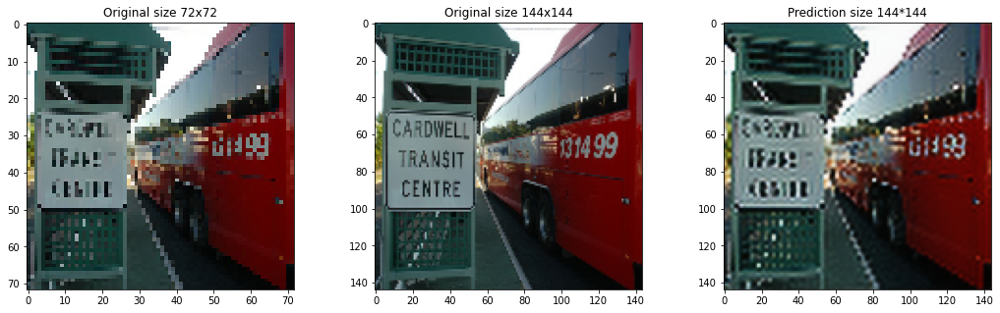

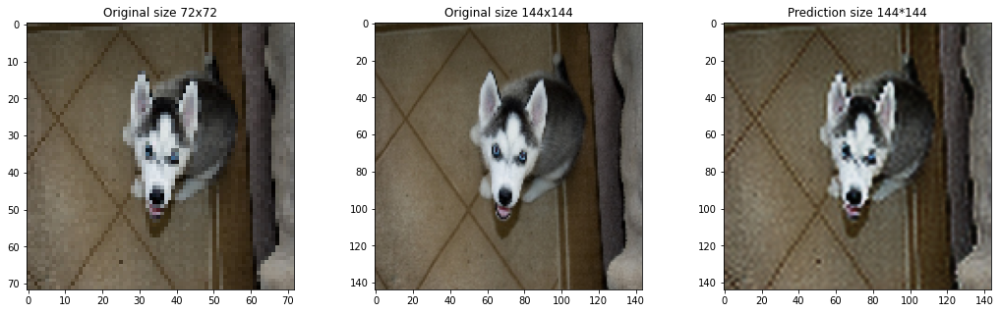

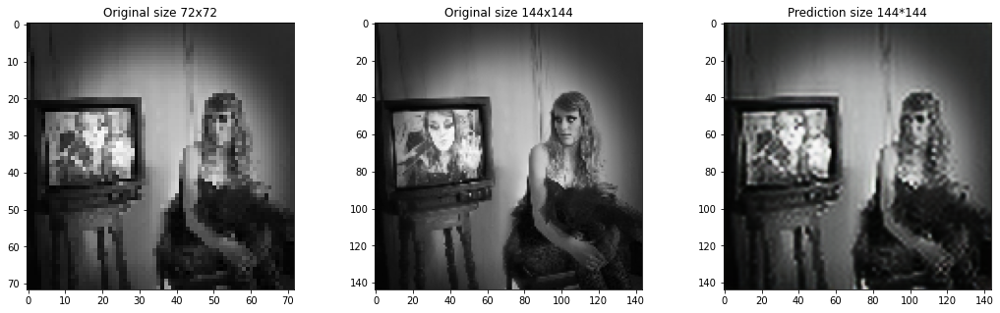

In [28]:
plot_three_images_pred(3,x2,y_mid2,pred1,0)

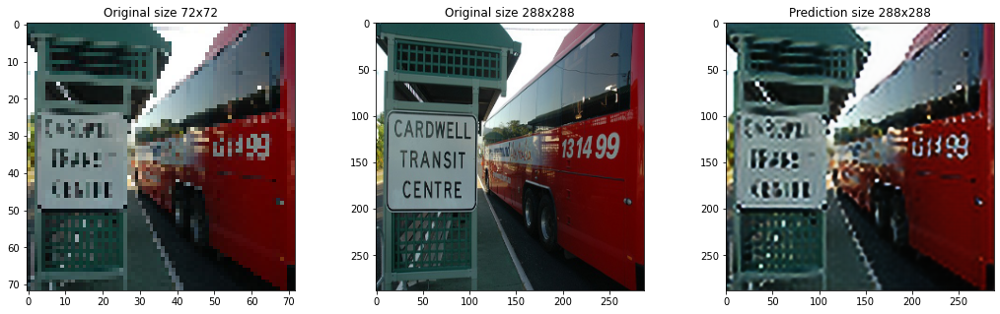

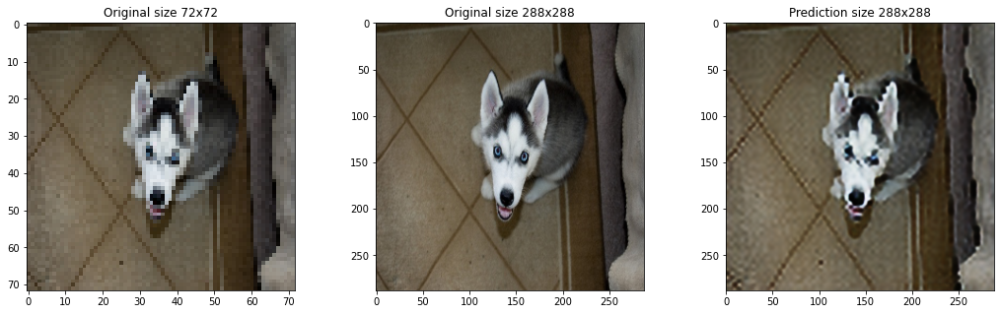

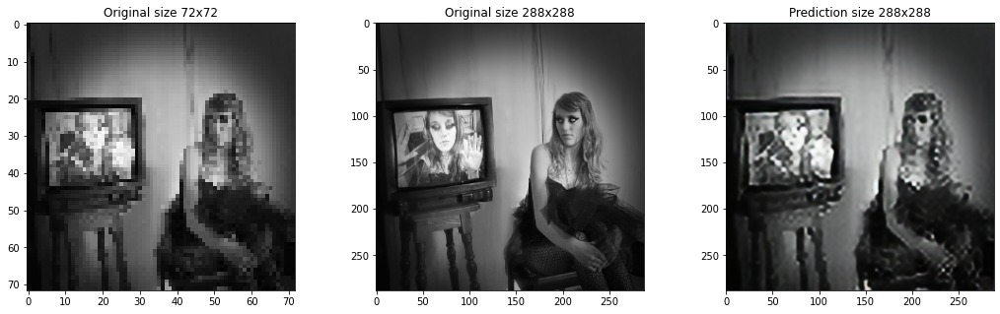

In [29]:
plot_three_images_pred(3,x2,y_large2,pred2,1)

## **Model 6 improvment plotting PSNR and Loss by epoch**

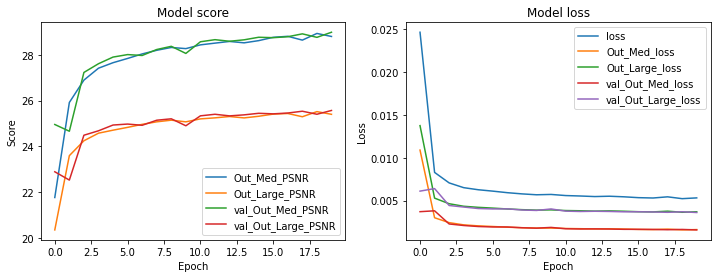

In [30]:
history_to_plot(history_6_1, scores, losses)

## **Gif for model 6 improved predictions**

In [31]:
create_gif('model_6_1',1,3)

Image(value=b'GIF89a \x01 \x01\x87\x00\x00\xf8\xfa\xfc\xf8\xf9\xfb\xf7\xf8\xfb\xf7\xf7\xfa\xf6\xf5\xf9\xf4\xf7…